<a href="https://colab.research.google.com/github/rutvikvijjali/vae-face-generator/blob/master/Variational_Autoencoder.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
!wget https://cswww.essex.ac.uk/mv/allfaces/faces94.zip

--2019-04-13 16:11:08--  https://cswww.essex.ac.uk/mv/allfaces/faces94.zip
Resolving cswww.essex.ac.uk (cswww.essex.ac.uk)... 155.245.92.179
Connecting to cswww.essex.ac.uk (cswww.essex.ac.uk)|155.245.92.179|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 18845407 (18M) [application/zip]
Saving to: ‘faces94.zip.1’

faces94.zip.1       100%[===================>]  17.97M  13.5MB/s    in 1.3s    

2019-04-13 16:11:10 (13.5 MB/s) - ‘faces94.zip.1’ saved [18845407/18845407]



In [0]:
!unzip faces94.zip

Archive:  faces94.zip
replace faces94/female/9336923/9336923.1.jpg? [y]es, [n]o, [A]ll, [N]one, [r]ename: N


In [0]:
import os
from PIL import Image
import numpy as np
%matplotlib inline

In [0]:
def load_images(path,width=128,height=128):
  count = 0
  images = []
  valid_ext = ["jpg","gif","png","tga"]
  for root, dirnames, filenames in os.walk(path):
        for filename in filenames:
            file = os.path.join(root, filename)
            ext = str(file.split(".")[-1])
            if ext in valid_ext:
              image = Image.open(file)
#               print(len(np.shape(np.array(image)))
              if(len(np.shape(np.array(image))) == 3):
                image_r = image.resize((width, height), Image.ANTIALIAS)    # best down-sizing filter
                if (count>10000):
                  break
                images.append(np.asarray(image_r))
                count+=1
                
  return images

In [0]:
images = load_images('faces94')

In [0]:
len(images)

3059

In [0]:
import numpy as np
import tensorflow as tf

In [0]:
def scale(x, feature_range=(0, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [0]:
scaled_images = [scale(image) for image in images]

In [0]:
from matplotlib.pyplot import imshow

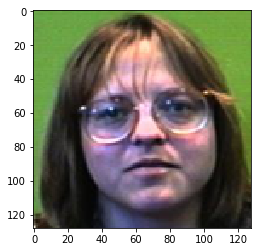

In [0]:
imshow(scaled_images[0])

In [0]:

  
def return_batches(batch_size,inputs):
  idx = np.arange(len(inputs))
  np.random.shuffle(idx)
  inputs = [inputs[i] for i in idx]
  n_batches = len(inputs) 
  
  for i in range(0, n_batches, batch_size):
    x = inputs[i:i+batch_size]

    
    yield x


In [0]:
import matplotlib.pyplot as plt
%matplotlib inline

In [0]:
class Autoencoder():
  
  
  
  def encoder(self,img):

    x = tf.layers.Conv2D(filters = 128, strides = 2, kernel_size = 3, padding = 'same', activation=tf.nn.relu)(img)
    x = tf.layers.batch_normalization(x, training=True)
#     x = tf.layers.MaxPooling2D(pool_size = 2, strides = 2, padding = 'same')(x)
    
    
    
    x = tf.layers.Conv2D(filters = 64, strides = 2, kernel_size = 3, padding = 'same',activation=tf.nn.relu)(x)
    x = tf.layers.batch_normalization(x, training=True)
#     x = tf.layers.MaxPooling2D(pool_size = 2, strides = 2, padding = 'same')(x)
    
    
    x = tf.layers.Conv2D(filters = 32, strides = 2, kernel_size = 3, padding = 'same', activation=tf.nn.relu)(x)
    x = tf.layers.batch_normalization(x, training=True)
#     x = tf.layers.MaxPooling2D(pool_size = 2, strides = 2, padding = 'same')(x)
    
    x = tf.layers.Conv2D(filters = 16, strides = 2, kernel_size = 3, padding = 'same', activation=tf.nn.relu)(x)
    x = tf.layers.batch_normalization(x, training=True)
#     x = tf.layers.MaxPooling2D(pool_size = 2, strides = 2, padding = 'same')(x)
    
    
    x = tf.reshape(x,(-1,8*8*16))
#     out = tf.layers.Dense(100)(x)


    log_var = tf.layers.Dense(50,kernel_initializer=tf.contrib.layers.xavier_initializer())(x)
    log_var = tf.layers.batch_normalization(log_var, training=True)
    mean = tf.layers.Dense(50,kernel_initializer=tf.contrib.layers.xavier_initializer())(x)
    mean = tf.layers.batch_normalization(mean, training=True)
    
    
    latent_vec = self.sampler(mean,log_var)
    return mean,log_var,latent_vec
  
  def sampler(self, mean, log_stddev):
    # we sample from the standard normal a matrix of batch_size * latent_size (taking into account minibatches)
    std_norm = tf.random_normal(shape=(tf.shape(mean)[0], 50), mean=0, stddev=1)
    # sampling from Z~N(μ, σ^2) is the same as sampling from μ + σX, X~N(0,1)
    return mean + tf.exp(log_stddev) * std_norm
  
  def decoder(self,latent_vector):
    
    x = tf.layers.Dense(8*8*16)(latent_vector)
    x = tf.reshape(x,(-1,8,8,16))

#     x = tf.image.resize_nearest_neighbor(x,(8,8))
    # Now 8x8x16
    x = tf.layers.Conv2DTranspose(filters = 8,kernel_size = 3, strides = 2, padding='same',activation=tf.nn.relu,kernel_initializer=tf.contrib.layers.xavier_initializer())(x)
    x = tf.layers.batch_normalization(x, training=True)
    # Now 16x16x8
#     x = tf.image.resize_nearest_neighbor(x,(16,16))
    # Now 16x16x8
    x = tf.layers.Conv2DTranspose(16,3, strides = 2, padding='same',activation=tf.nn.relu,kernel_initializer=tf.contrib.layers.xavier_initializer())(x)
    x = tf.layers.batch_normalization(x, training=True)
    # Now 32x32x16
#     x = tf.image.resize_nearest_neighbor(x,(32,32))
    # Now 32x32x16
    x = tf.layers.Conv2DTranspose(32,3,strides = 2, padding='same',activation=tf.nn.relu,kernel_initializer=tf.contrib.layers.xavier_initializer())(x)
    x = tf.layers.batch_normalization(x, training=True)
    # Now 64x64x32
#     x = tf.image.resize_nearest_neighbor(x,(64,64))
    # Now 64x64x32
    x = tf.layers.Conv2DTranspose(64,3, strides = 2,padding='same',activation=tf.nn.relu,kernel_initializer=tf.contrib.layers.xavier_initializer())(x)
    x = tf.layers.batch_normalization(x, training=True)
    # Now 128x128x64
#     x = tf.image.resize_nearest_neighbor(x,(128,128))
    # Now 128x128x64
    logits = tf.layers.Conv2DTranspose(3,3,padding='same',activation=None)(x)
    # Now 128x128x3
    
    decoded = tf.nn.sigmoid(logits,name='decoded')

    return logits, decoded
  
  

  def __init__(self):
     
      self.inp = tf.placeholder(shape=(None,128,128,3), dtype = tf.float32)
      self.mean,self.std_dev,self.latent_vec = self.encoder(self.inp)
      self.kl_loss = - 0.5 * tf.keras.backend.sum(1 + self.std_dev - tf.square(self.mean) - tf.square(tf.exp(self.std_dev)), axis=-1)
      self.dec_log, self.dec_out= self.decoder(self.latent_vec)

#       self.optimizer = tf.train.AdamOptimizer(learning_rate= 0.002).minimize(self.loss)
      self.reconstruction_loss = tf.reduce_mean(tf.square(self.inp-self.dec_out))
      self.kl_loss = - 0.5 * tf.keras.backend.sum(1 + self.std_dev - tf.square(self.mean) - tf.square(tf.exp(self.std_dev)), axis=-1)
#       self.loss = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(labels = self.inp, logits = self.dec_log))
      self.loss = tf.reduce_mean(self.reconstruction_loss + 0.001*self.kl_loss)
      with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        self.optimizer = tf.train.AdamOptimizer(0.01).minimize(self.loss)

Instructions for updating:
Colocations handled automatically by placer.
Instructions for updating:
Use keras.layers.batch_normalization instead.

For more information, please see:
  * https://github.com/tensorflow/community/blob/master/rfcs/20180907-contrib-sunset.md
  * https://github.com/tensorflow/addons
If you depend on functionality not listed there, please file an issue.

Instructions for updating:
Use tf.cast instead.
(32, 128, 128, 3)


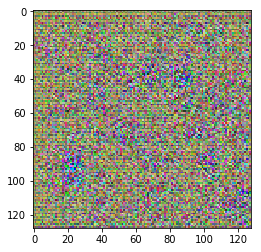

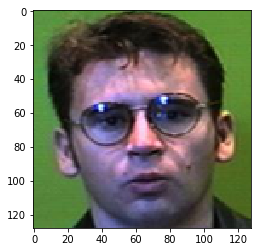

162.66052
(32, 128, 128, 3)


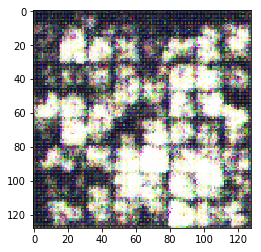

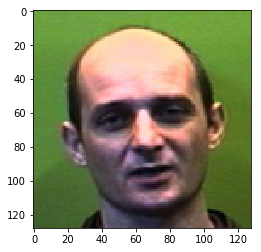

136.19208
(32, 128, 128, 3)


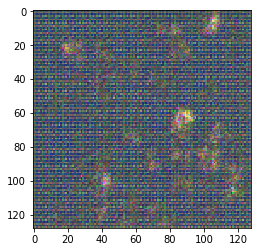

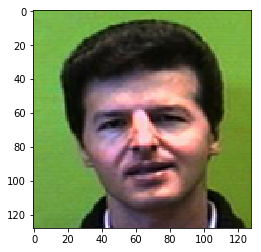

159.64517
(32, 128, 128, 3)


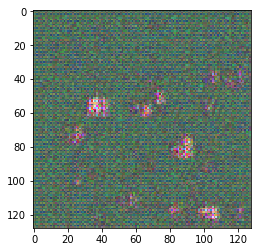

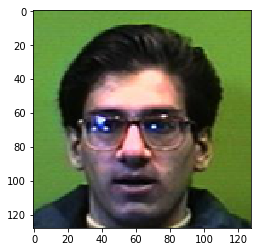

132.88736
(32, 128, 128, 3)


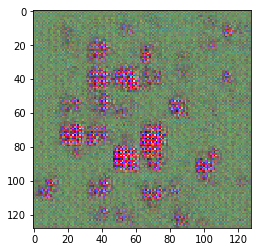

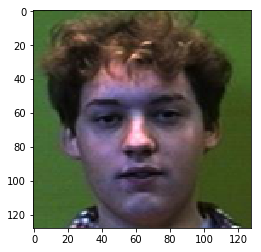

103.57328
(32, 128, 128, 3)


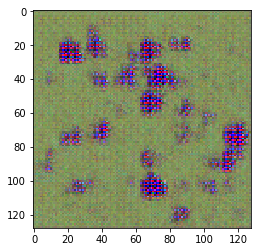

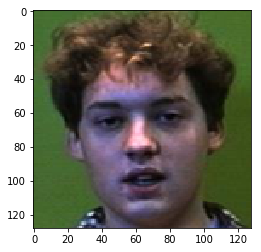

89.91228
(32, 128, 128, 3)


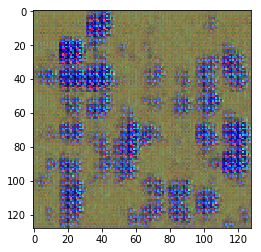

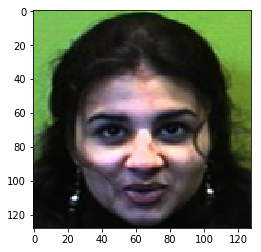

84.30959
(32, 128, 128, 3)


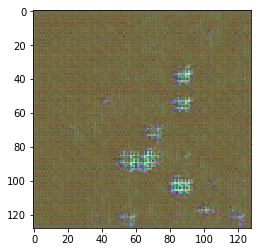

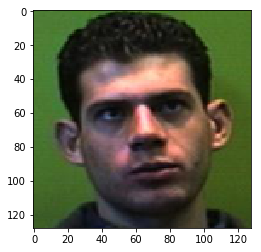

77.49242
(32, 128, 128, 3)


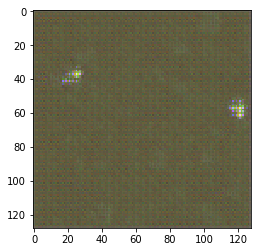

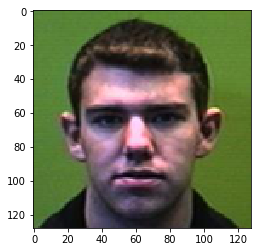

70.32109
(32, 128, 128, 3)


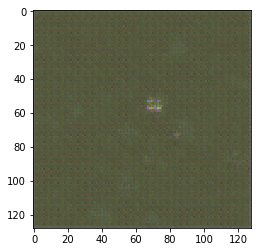

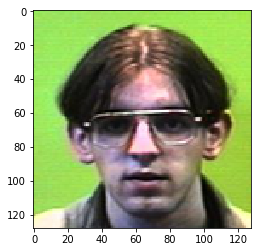

62.520046
(32, 128, 128, 3)


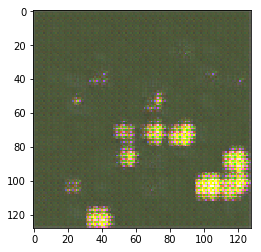

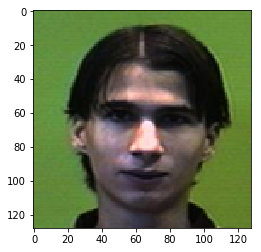

59.808975
(32, 128, 128, 3)


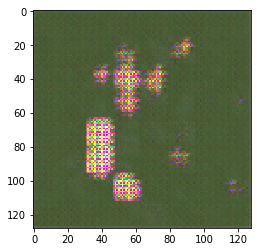

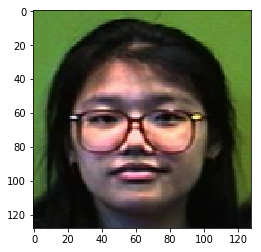

59.141956
(32, 128, 128, 3)


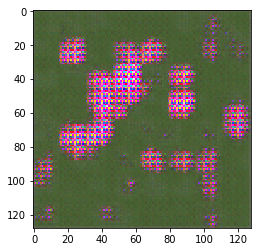

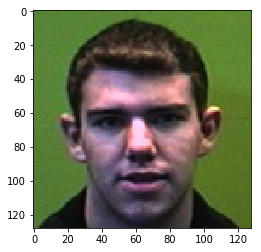

58.97029
(32, 128, 128, 3)


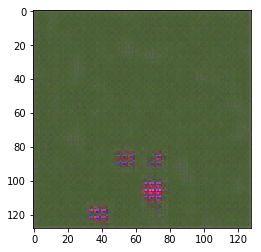

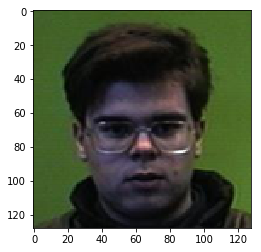

51.0644
(32, 128, 128, 3)


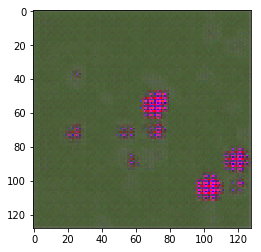

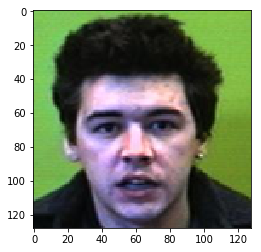

49.011032
(32, 128, 128, 3)


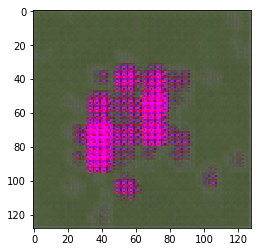

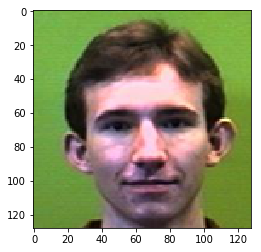

48.413483
(32, 128, 128, 3)


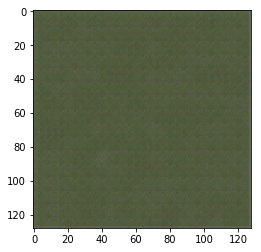

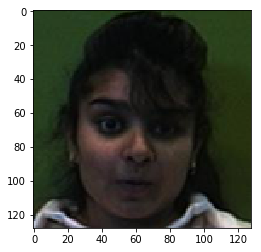

45.96064
(32, 128, 128, 3)


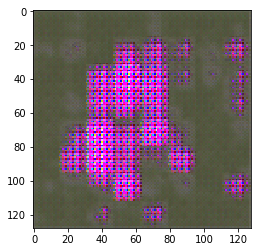

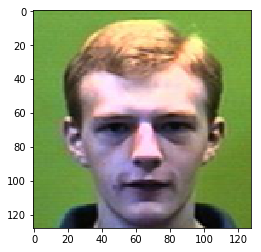

42.734615
(32, 128, 128, 3)


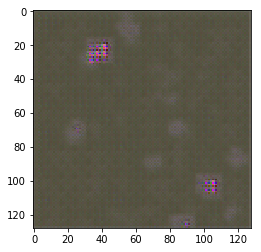

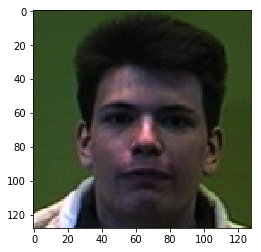

42.96963
(32, 128, 128, 3)


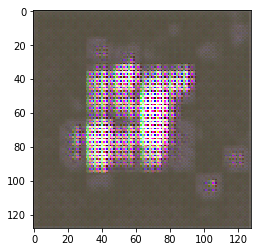

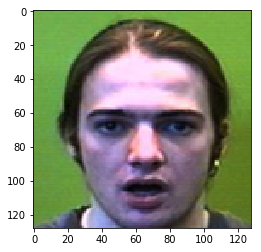

36.90612
(32, 128, 128, 3)


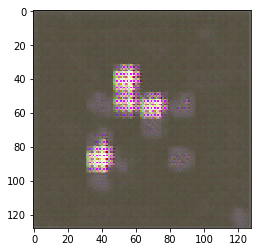

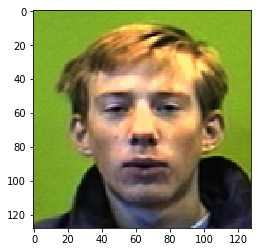

39.920784
(32, 128, 128, 3)


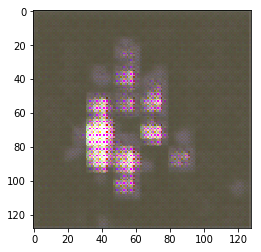

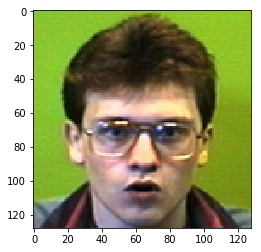

37.81321
(32, 128, 128, 3)


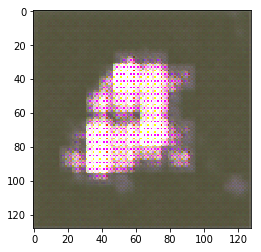

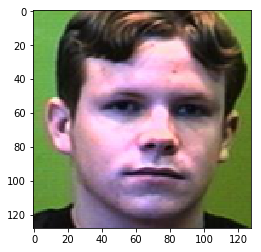

35.000168
(32, 128, 128, 3)


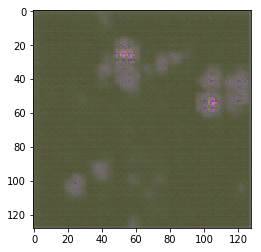

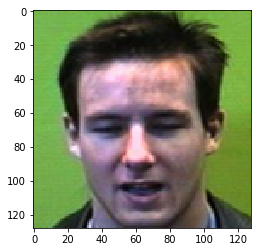

35.04579
(32, 128, 128, 3)


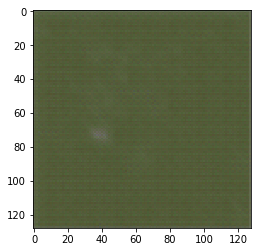

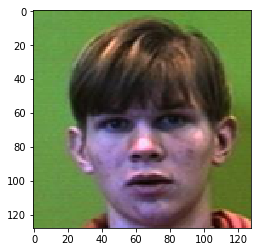

31.932743
(32, 128, 128, 3)


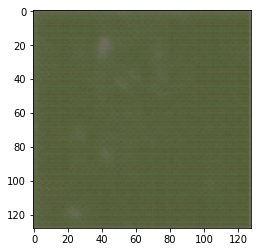

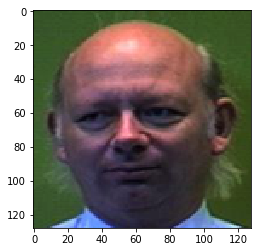

32.222126
(32, 128, 128, 3)


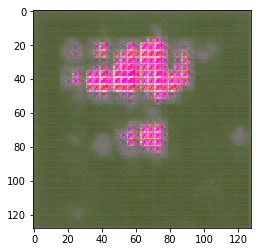

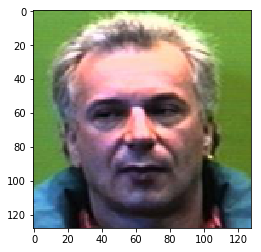

31.396194
(32, 128, 128, 3)


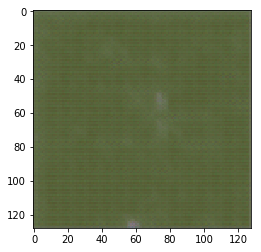

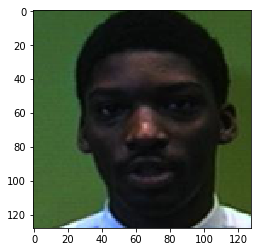

30.170757
(32, 128, 128, 3)


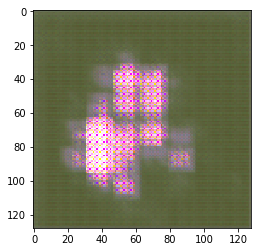

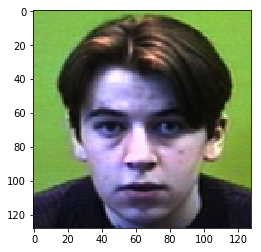

28.981188
(32, 128, 128, 3)


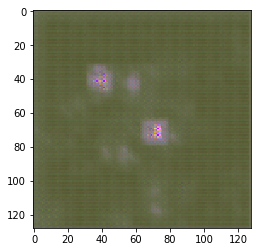

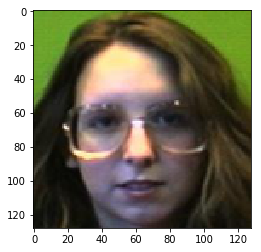

26.642197
(32, 128, 128, 3)


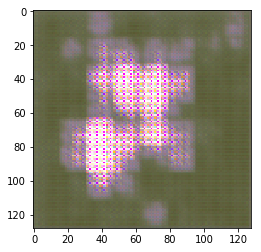

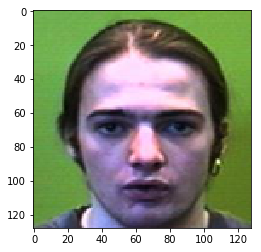

29.379444
(32, 128, 128, 3)


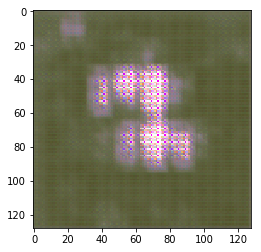

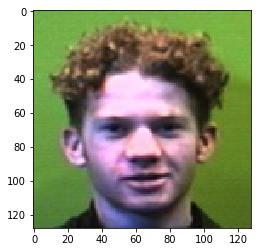

27.736267
(32, 128, 128, 3)


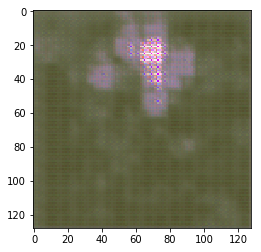

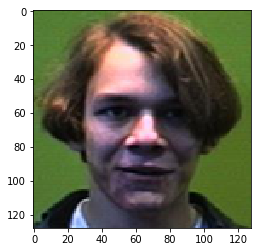

25.233852
(32, 128, 128, 3)


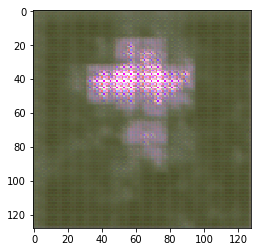

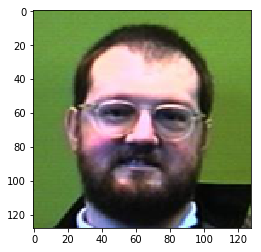

23.896425
(32, 128, 128, 3)


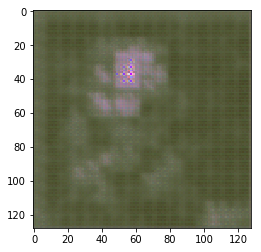

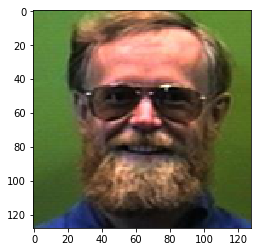

22.257704
(32, 128, 128, 3)


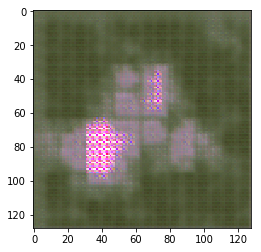

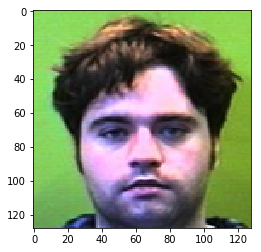

21.50228
(32, 128, 128, 3)


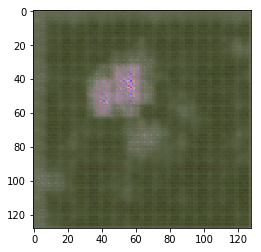

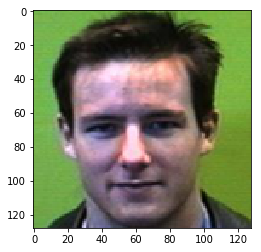

23.730145
(32, 128, 128, 3)


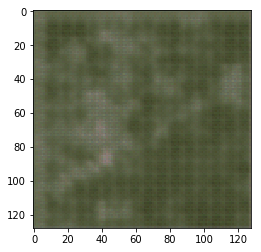

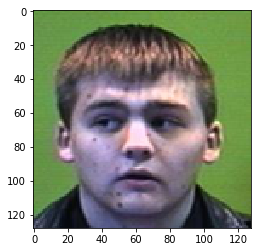

22.361595
(32, 128, 128, 3)


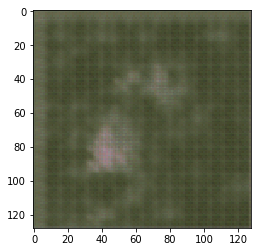

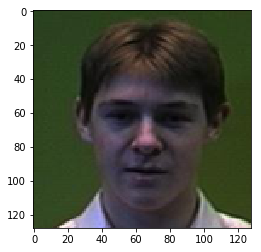

21.57055
(32, 128, 128, 3)


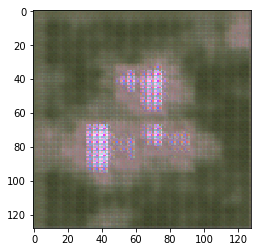

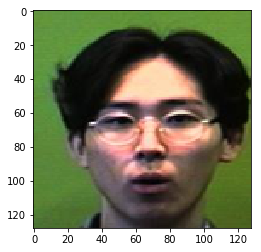

22.220844
(32, 128, 128, 3)


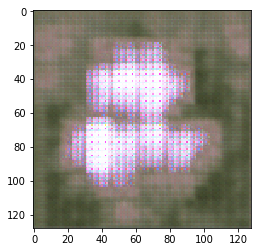

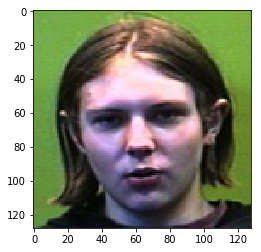

21.60444
(32, 128, 128, 3)


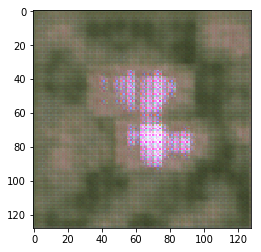

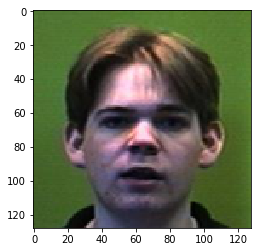

21.828789
(32, 128, 128, 3)


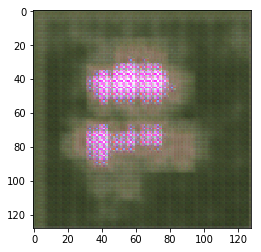

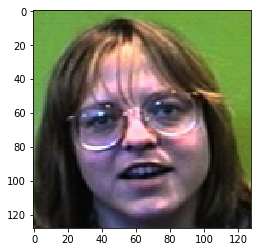

20.05934
(32, 128, 128, 3)


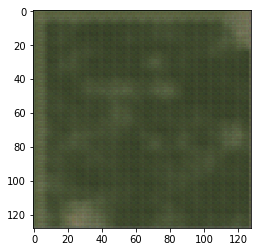

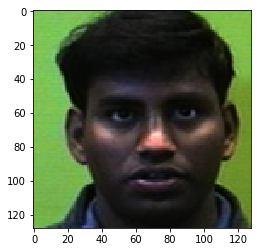

19.805803
(32, 128, 128, 3)


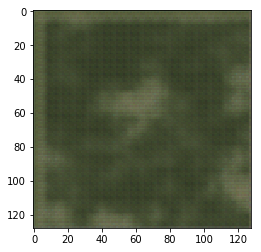

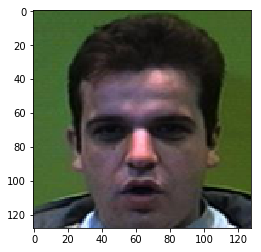

16.974749
(32, 128, 128, 3)


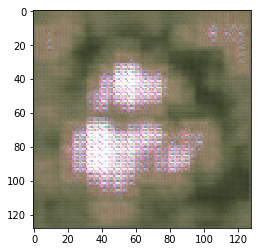

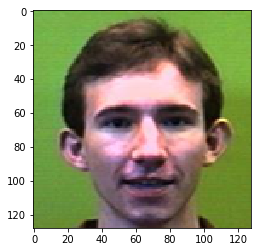

20.05677
(32, 128, 128, 3)


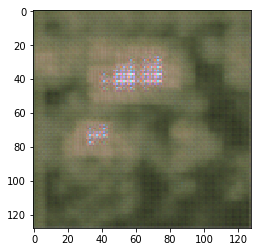

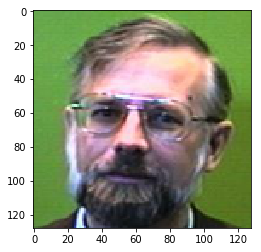

17.758125
(32, 128, 128, 3)


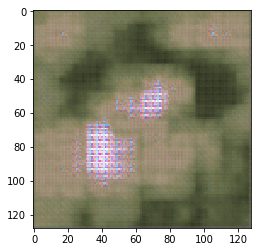

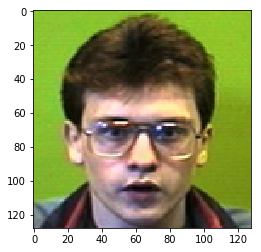

14.74074
(32, 128, 128, 3)


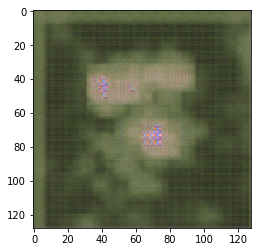

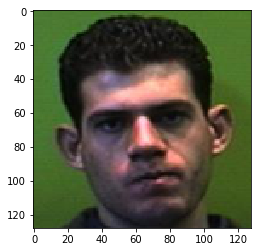

16.977913
(32, 128, 128, 3)


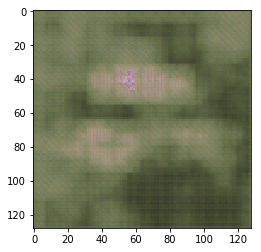

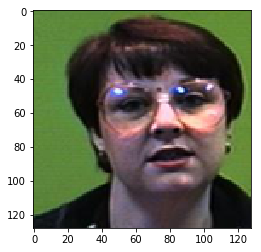

15.911068
(32, 128, 128, 3)


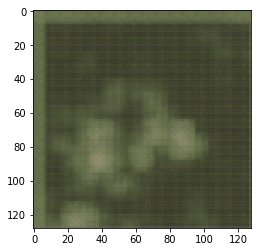

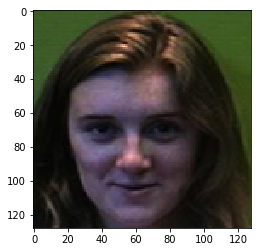

15.927624
(32, 128, 128, 3)


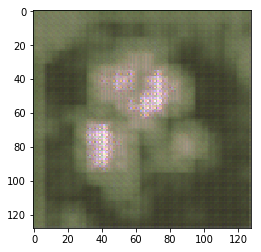

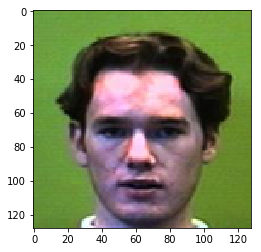

15.077819
(32, 128, 128, 3)


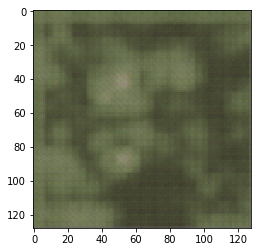

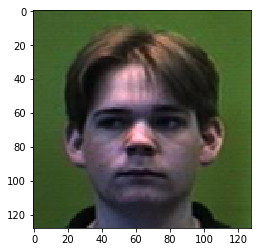

15.293491
(32, 128, 128, 3)


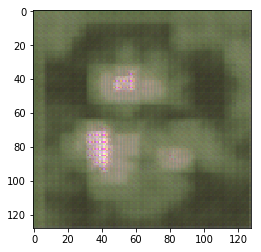

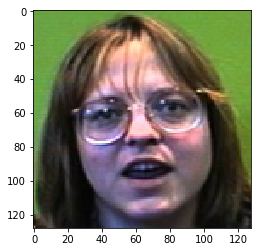

15.080557
(32, 128, 128, 3)


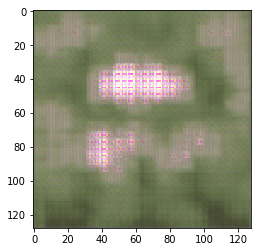

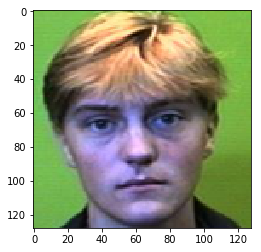

14.7189045
(32, 128, 128, 3)


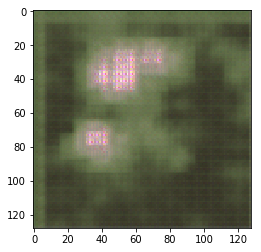

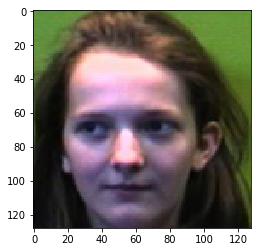

14.559755
(32, 128, 128, 3)


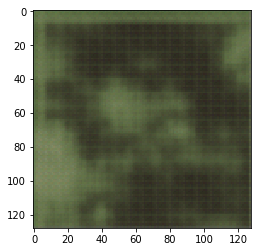

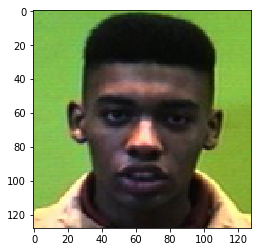

14.324337
(32, 128, 128, 3)


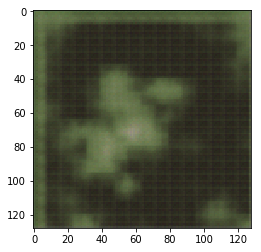

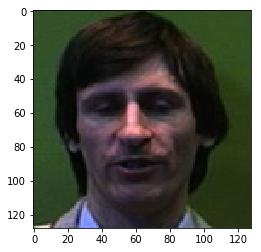

12.047697
(32, 128, 128, 3)


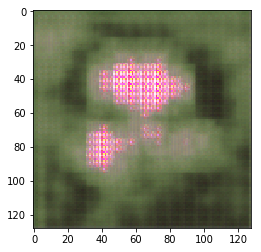

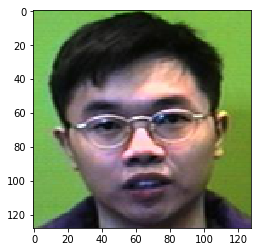

13.468599
(32, 128, 128, 3)


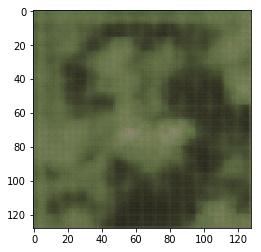

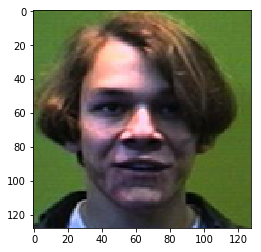

13.993455
(32, 128, 128, 3)


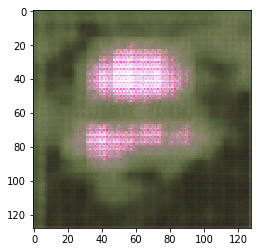

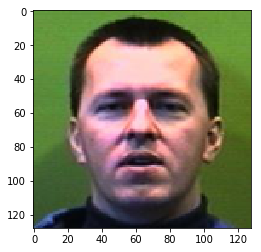

11.769182
(32, 128, 128, 3)


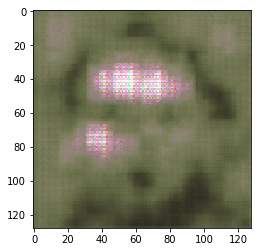

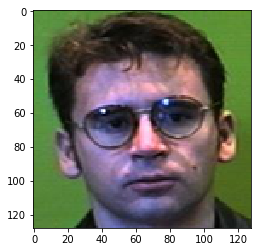

12.51829
(32, 128, 128, 3)


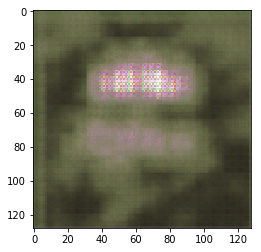

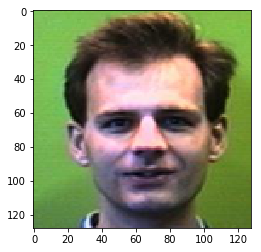

11.9846
(32, 128, 128, 3)


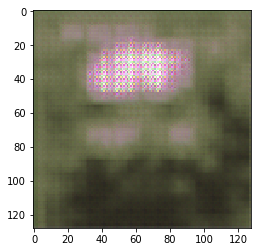

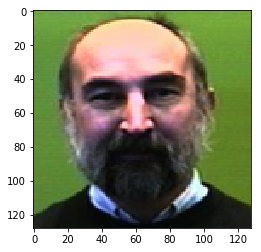

10.070772
(32, 128, 128, 3)


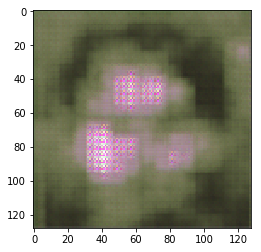

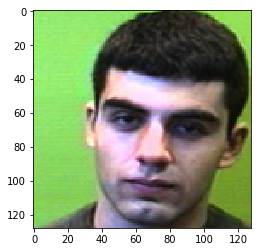

9.840348
(32, 128, 128, 3)


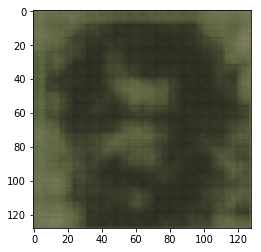

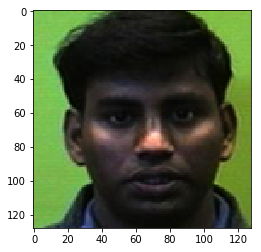

10.417443
(32, 128, 128, 3)


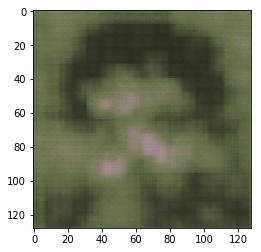

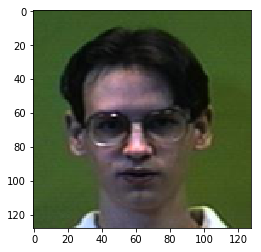

9.320783
(32, 128, 128, 3)


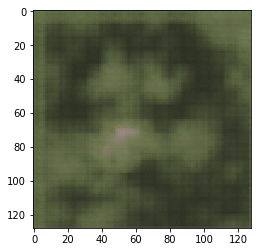

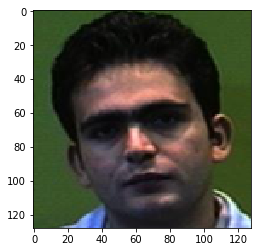

9.850149
(32, 128, 128, 3)


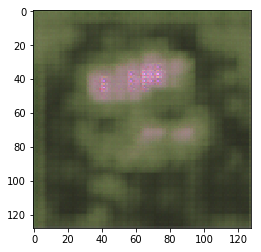

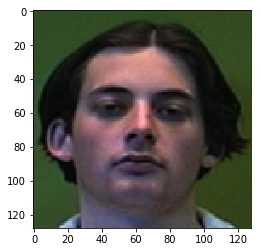

10.300913
(32, 128, 128, 3)


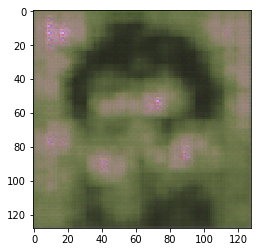

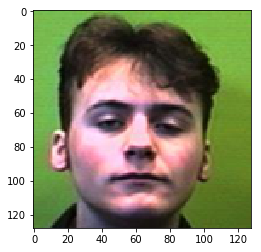

10.03117
(32, 128, 128, 3)


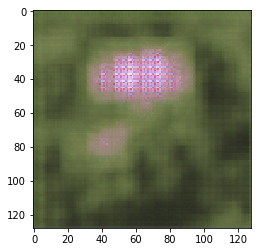

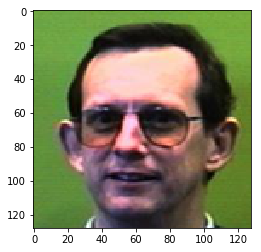

7.87716
(32, 128, 128, 3)


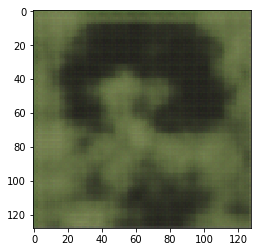

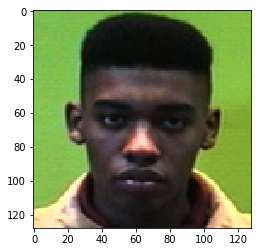

8.683851
(32, 128, 128, 3)


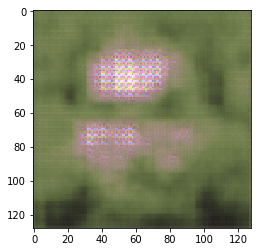

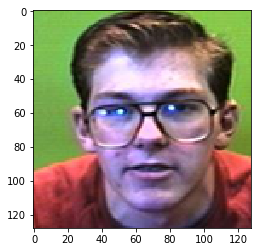

7.7468457
(32, 128, 128, 3)


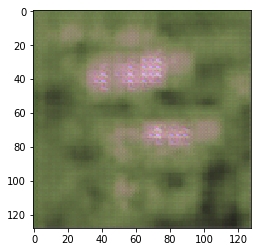

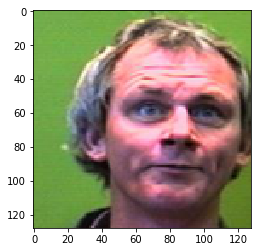

8.332328
(32, 128, 128, 3)


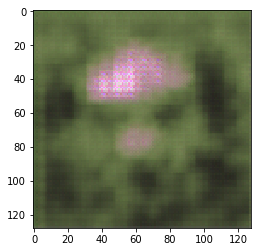

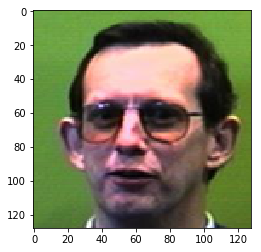

7.7583694
(32, 128, 128, 3)


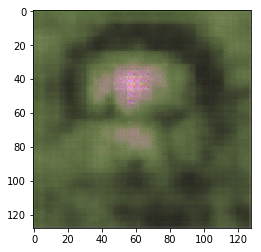

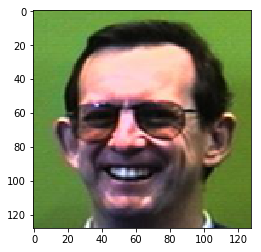

7.2724886
(32, 128, 128, 3)


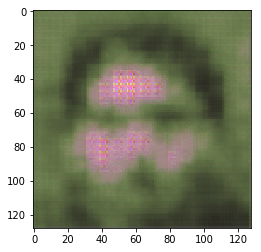

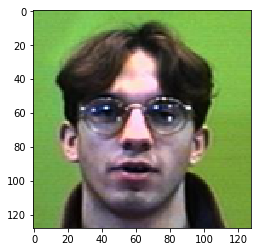

7.4986806
(32, 128, 128, 3)


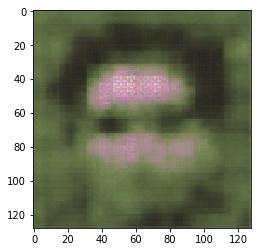

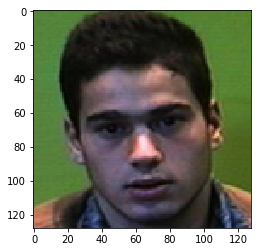

7.08836
(32, 128, 128, 3)


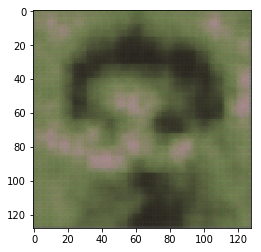

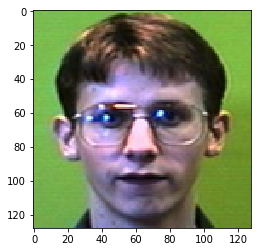

6.3104753
(32, 128, 128, 3)


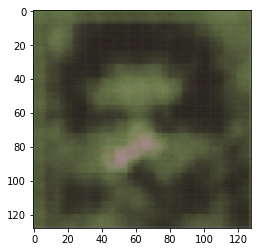

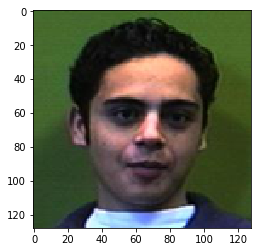

7.3674636
(32, 128, 128, 3)


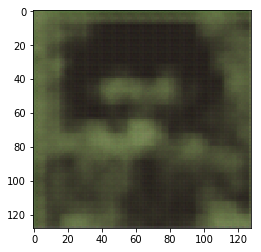

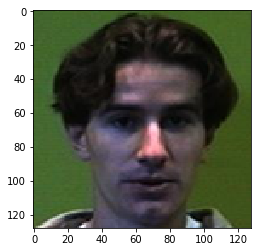

7.1905756
(32, 128, 128, 3)


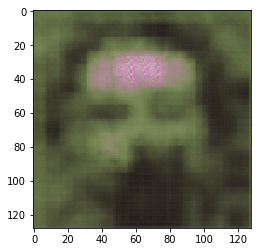

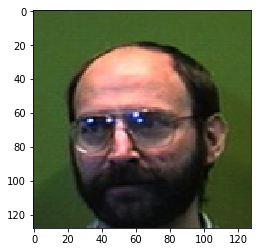

6.2142363
(32, 128, 128, 3)


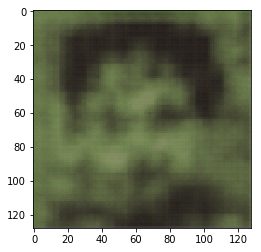

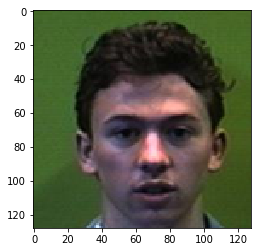

6.1601286
(32, 128, 128, 3)


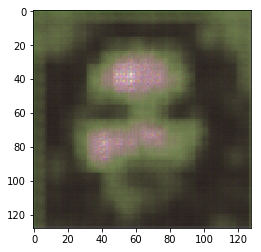

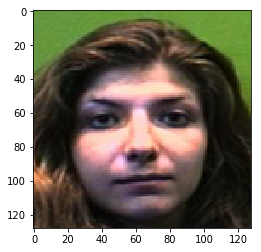

6.3636503
(32, 128, 128, 3)


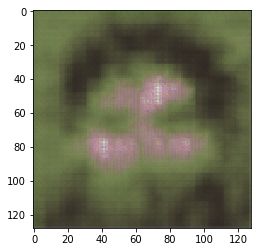

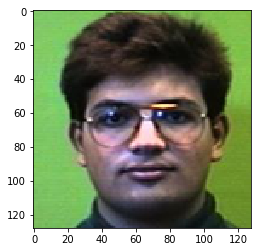

6.129294
(32, 128, 128, 3)


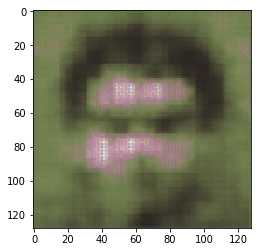

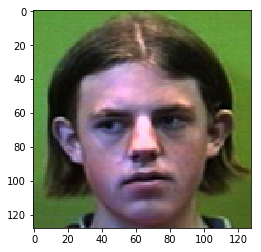

6.352166
(32, 128, 128, 3)


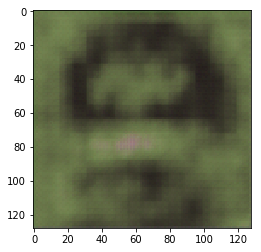

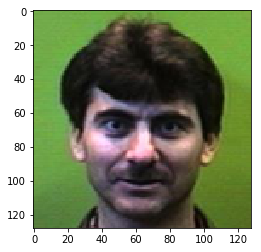

5.828292
(32, 128, 128, 3)


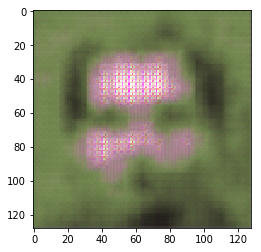

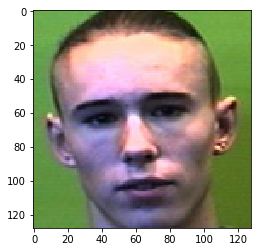

5.632228
(32, 128, 128, 3)


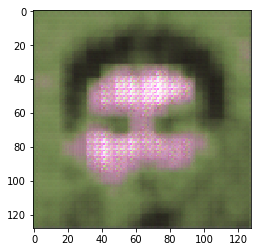

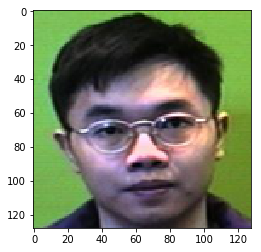

5.006005
(32, 128, 128, 3)


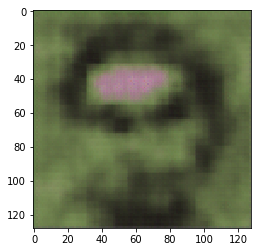

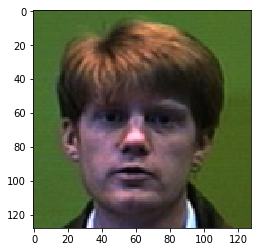

5.577184
(32, 128, 128, 3)


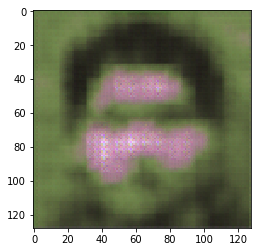

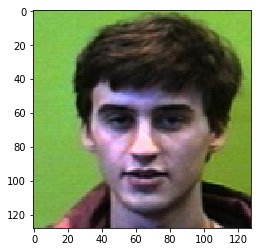

4.720051
(32, 128, 128, 3)


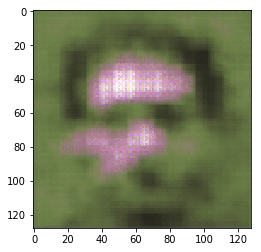

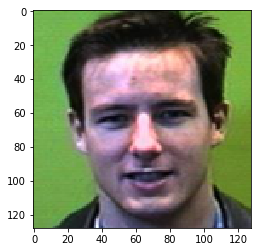

4.764976
(32, 128, 128, 3)


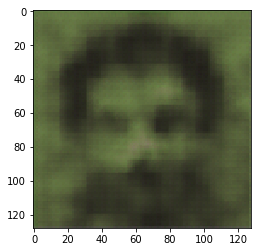

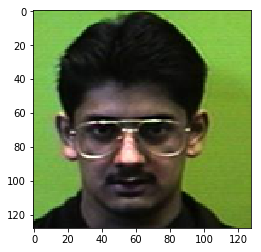

5.074606
(32, 128, 128, 3)


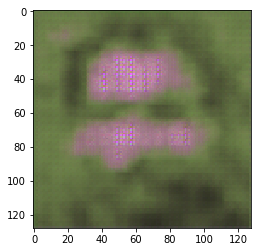

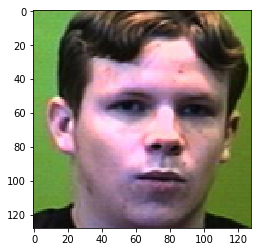

3.584013
(32, 128, 128, 3)


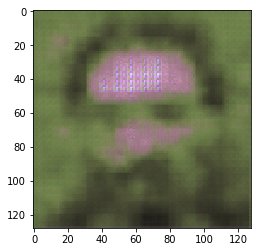

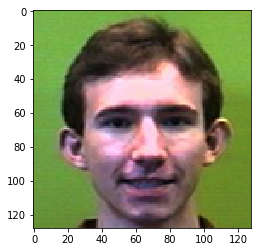

4.132834
(19, 128, 128, 3)


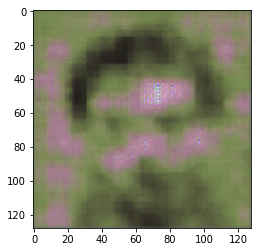

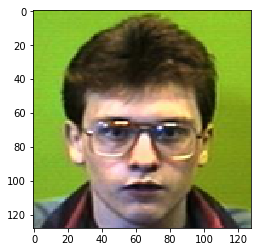

5.372779


In [0]:
tf.reset_default_graph()
net = Autoencoder()

dat = scaled_images[8:12]
sess = tf.Session()

sess.run(tf.global_variables_initializer())

# che = sess.run(net.t, feed_dict={net.inp:dat})
for x in return_batches(32,scaled_images):
  print(np.shape(x))
  _,out,l = sess.run([net.optimizer,net.dec_out,net.loss],feed_dict={net.inp:x})
#   print(out[0])
  imshow(out[0])
  plt.show()
  imshow(x[0])
  plt.show()
  print(l)

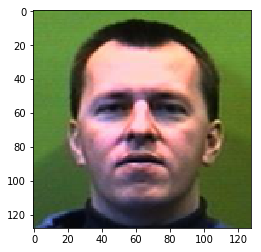

In [0]:
imshow(scaled_images[100])

In [0]:
scaled_images[0].max()

1.0

In [0]:
np.shape(che)

(4, 128, 128, 3)

In [0]:
8*8*16

1024

In [0]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(10, 5)):
    saver = tf.train.Saver()
#     sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        
        sample = dataset[0:72]
        for e in range(epochs):
            for x in return_batches(batch_size,dataset):
                steps += 1
                _ = sess.run(net.optimizer,feed_dict={net.inp:x})
                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    loss = sess.run(net.loss, feed_dict={net.inp:x})
                    print("Epoch {}/{}...".format(e + 1, epochs),
                          "Loss: {:.4f}...".format(loss))
                    # Save losses to view after training
                    losses.append(loss)
                    gen_samples = sess.run(net.dec_out, feed_dict={net.inp:x})
                    

                    if steps % show_every == 0:

                      w=10
                      h=10
                      fig=plt.figure(figsize=(8, 8))
                      columns = 4
                      rows = 5
                      j = 1
                      for i in range(1, int(columns*rows/2) +1):
                          img = gen_samples[i]
                          real_img = x[i]
                          fig.add_subplot(rows, columns, j)
                          plt.imshow(img)
                          fig.add_subplot(rows, columns, j+1)
                          j+=2
                          plt.imshow(real_img)
                      plt.show()
#                 if steps % show_every == 0:
#                   print(np.shape(sample)) 
                  
#                   gen_samples = sess.run(
#                       net.dec_out,
#                       feed_dict={net.inp: np.asarray(sample)})
#                   samples.append(gen_samples)
#                   _ = view_samples(-1, samples, 6, 6, figsize=figsize)
#                   plt.show()

        saver.save(sess, './checkpoints/ae.ckpt')

#     with open('samples.pkl', 'wb') as f:
#         pickle.dump(samples, f)

    return losses, samples

In [0]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5, 5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols,
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = (img).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')

    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

In [0]:
tf.reset_default_graph()
net = Autoencoder()


Epoch 1/100... Loss: 0.1159...
Epoch 1/100... Loss: 0.0842...
Epoch 1/100... Loss: 0.0700...
Epoch 1/100... Loss: 0.0619...
Epoch 2/100... Loss: 0.0513...
Epoch 2/100... Loss: 0.0468...
Epoch 2/100... Loss: 0.0420...
Epoch 2/100... Loss: 0.0377...
Epoch 2/100... Loss: 0.0359...
Epoch 3/100... Loss: 0.0365...


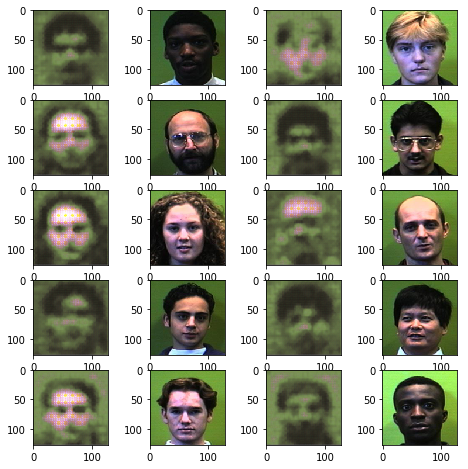

Epoch 3/100... Loss: 0.0333...
Epoch 3/100... Loss: 0.0314...
Epoch 3/100... Loss: 0.0333...
Epoch 3/100... Loss: 0.0315...
Epoch 4/100... Loss: 0.0327...
Epoch 4/100... Loss: 0.0298...
Epoch 4/100... Loss: 0.0274...
Epoch 4/100... Loss: 0.0287...
Epoch 4/100... Loss: 0.0277...
Epoch 5/100... Loss: 0.0270...


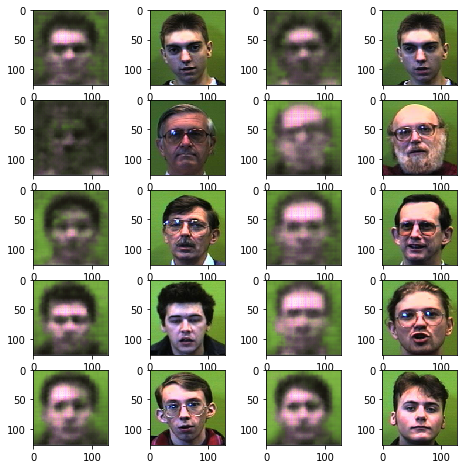

Epoch 5/100... Loss: 0.0261...
Epoch 5/100... Loss: 0.0269...
Epoch 5/100... Loss: 0.0253...
Epoch 5/100... Loss: 0.0247...
Epoch 6/100... Loss: 0.0254...
Epoch 6/100... Loss: 0.0246...
Epoch 6/100... Loss: 0.0239...
Epoch 6/100... Loss: 0.0257...
Epoch 7/100... Loss: 0.0249...
Epoch 7/100... Loss: 0.0225...


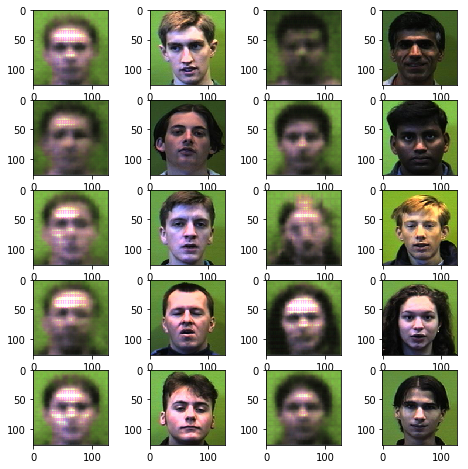

Epoch 7/100... Loss: 0.0232...
Epoch 7/100... Loss: 0.0230...
Epoch 7/100... Loss: 0.0236...
Epoch 8/100... Loss: 0.0230...
Epoch 8/100... Loss: 0.0231...
Epoch 8/100... Loss: 0.0214...
Epoch 8/100... Loss: 0.0216...
Epoch 8/100... Loss: 0.0209...
Epoch 9/100... Loss: 0.0221...
Epoch 9/100... Loss: 0.0212...


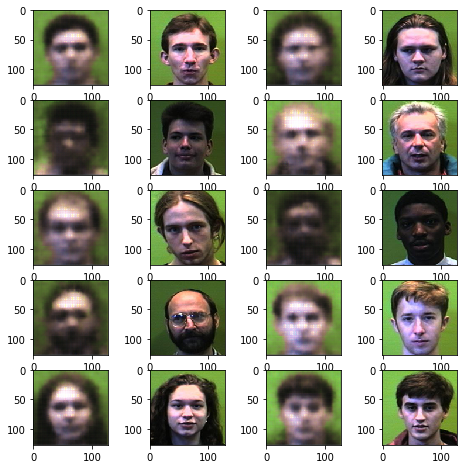

Epoch 9/100... Loss: 0.0219...
Epoch 9/100... Loss: 0.0223...
Epoch 9/100... Loss: 0.0216...
Epoch 10/100... Loss: 0.0200...
Epoch 10/100... Loss: 0.0207...
Epoch 10/100... Loss: 0.0204...
Epoch 10/100... Loss: 0.0196...
Epoch 10/100... Loss: 0.0208...
Epoch 11/100... Loss: 0.0216...
Epoch 11/100... Loss: 0.0199...


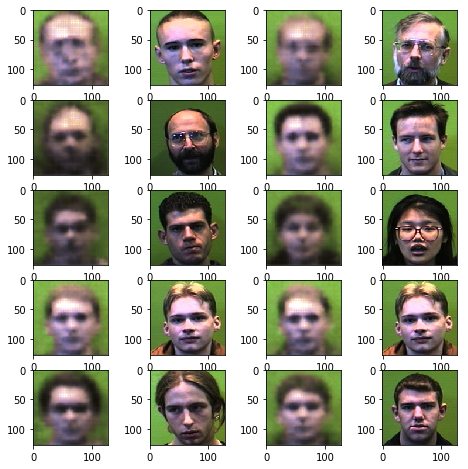

Epoch 11/100... Loss: 0.0187...
Epoch 11/100... Loss: 0.0193...
Epoch 12/100... Loss: 0.0196...
Epoch 12/100... Loss: 0.0182...
Epoch 12/100... Loss: 0.0211...
Epoch 12/100... Loss: 0.0188...
Epoch 12/100... Loss: 0.0186...
Epoch 13/100... Loss: 0.0178...
Epoch 13/100... Loss: 0.0182...
Epoch 13/100... Loss: 0.0202...


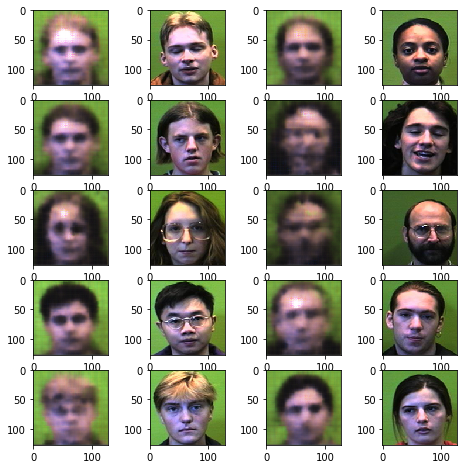

Epoch 13/100... Loss: 0.0189...
Epoch 13/100... Loss: 0.0190...
Epoch 14/100... Loss: 0.0180...
Epoch 14/100... Loss: 0.0173...
Epoch 14/100... Loss: 0.0184...
Epoch 14/100... Loss: 0.0174...
Epoch 14/100... Loss: 0.0201...
Epoch 15/100... Loss: 0.0193...
Epoch 15/100... Loss: 0.0180...
Epoch 15/100... Loss: 0.0176...


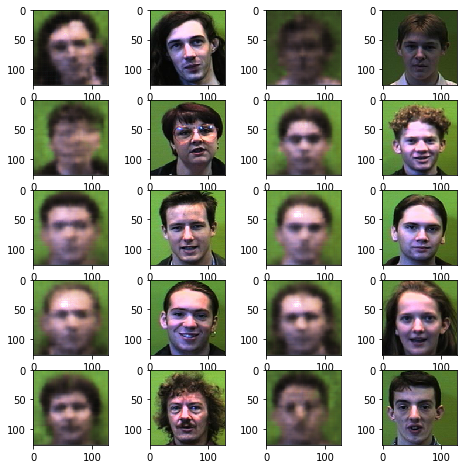

Epoch 15/100... Loss: 0.0170...
Epoch 15/100... Loss: 0.0181...
Epoch 16/100... Loss: 0.0175...
Epoch 16/100... Loss: 0.0171...
Epoch 16/100... Loss: 0.0168...
Epoch 16/100... Loss: 0.0180...
Epoch 17/100... Loss: 0.0169...
Epoch 17/100... Loss: 0.0175...
Epoch 17/100... Loss: 0.0179...
Epoch 17/100... Loss: 0.0185...


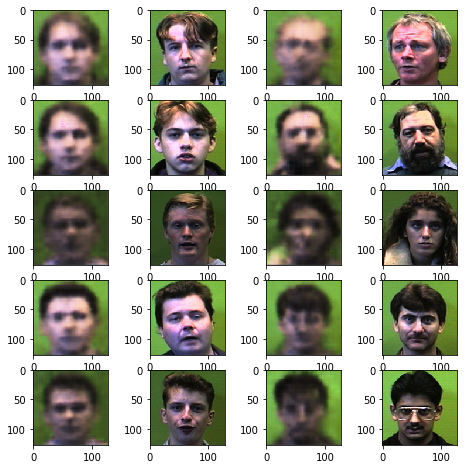

Epoch 17/100... Loss: 0.0165...
Epoch 18/100... Loss: 0.0159...
Epoch 18/100... Loss: 0.0172...
Epoch 18/100... Loss: 0.0172...
Epoch 18/100... Loss: 0.0174...
Epoch 18/100... Loss: 0.0183...
Epoch 19/100... Loss: 0.0161...
Epoch 19/100... Loss: 0.0176...
Epoch 19/100... Loss: 0.0172...
Epoch 19/100... Loss: 0.0174...


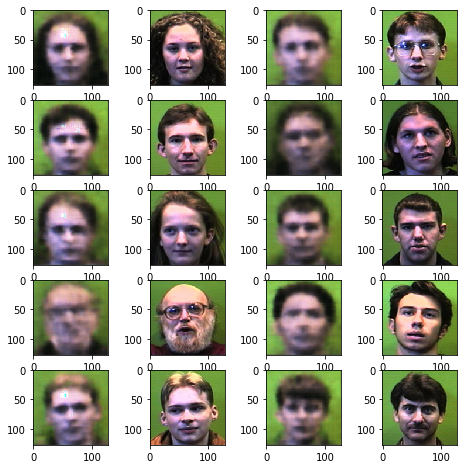

Epoch 19/100... Loss: 0.0176...
Epoch 20/100... Loss: 0.0165...
Epoch 20/100... Loss: 0.0173...
Epoch 20/100... Loss: 0.0163...
Epoch 20/100... Loss: 0.0175...
Epoch 20/100... Loss: 0.0174...
Epoch 21/100... Loss: 0.0169...
Epoch 21/100... Loss: 0.0167...
Epoch 21/100... Loss: 0.0172...
Epoch 21/100... Loss: 0.0166...


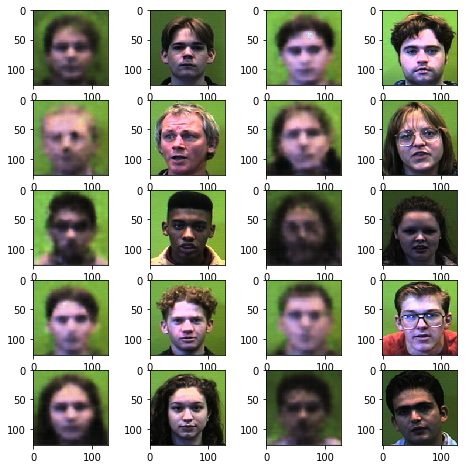

Epoch 22/100... Loss: 0.0167...
Epoch 22/100... Loss: 0.0174...
Epoch 22/100... Loss: 0.0163...
Epoch 22/100... Loss: 0.0173...
Epoch 22/100... Loss: 0.0171...
Epoch 23/100... Loss: 0.0171...
Epoch 23/100... Loss: 0.0172...
Epoch 23/100... Loss: 0.0168...
Epoch 23/100... Loss: 0.0168...
Epoch 23/100... Loss: 0.0161...


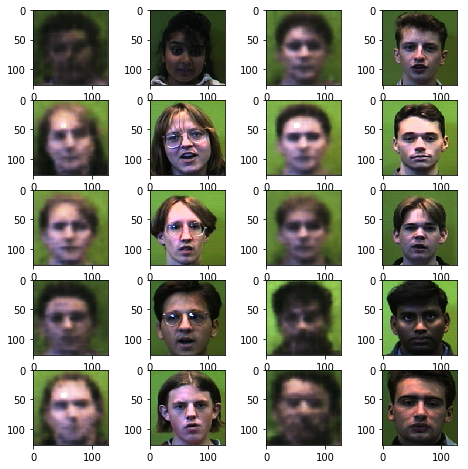

Epoch 24/100... Loss: 0.0166...
Epoch 24/100... Loss: 0.0182...
Epoch 24/100... Loss: 0.0167...
Epoch 24/100... Loss: 0.0163...
Epoch 24/100... Loss: 0.0164...
Epoch 25/100... Loss: 0.0180...
Epoch 25/100... Loss: 0.0162...
Epoch 25/100... Loss: 0.0170...
Epoch 25/100... Loss: 0.0163...
Epoch 25/100... Loss: 0.0154...


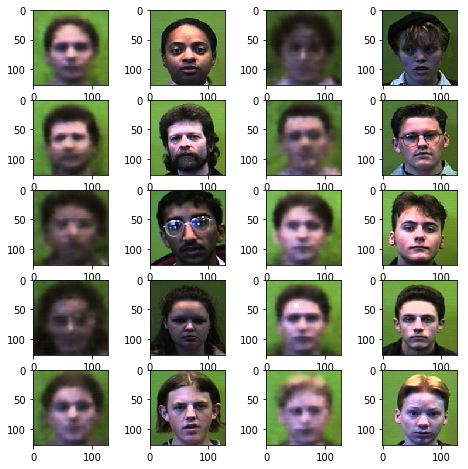

Epoch 26/100... Loss: 0.0164...
Epoch 26/100... Loss: 0.0162...
Epoch 26/100... Loss: 0.0162...
Epoch 26/100... Loss: 0.0172...
Epoch 27/100... Loss: 0.0171...
Epoch 27/100... Loss: 0.0156...
Epoch 27/100... Loss: 0.0169...
Epoch 27/100... Loss: 0.0155...
Epoch 27/100... Loss: 0.0181...
Epoch 28/100... Loss: 0.0161...


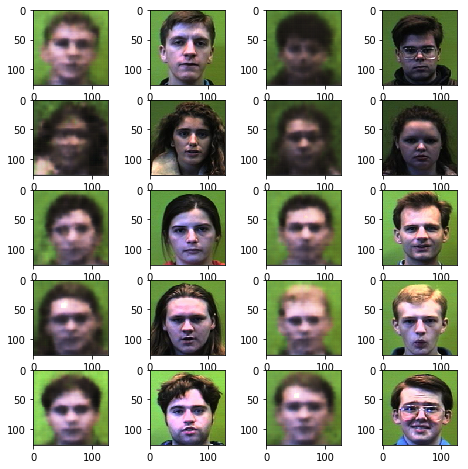

Epoch 28/100... Loss: 0.0162...
Epoch 28/100... Loss: 0.0159...
Epoch 28/100... Loss: 0.0155...
Epoch 28/100... Loss: 0.0164...
Epoch 29/100... Loss: 0.0172...
Epoch 29/100... Loss: 0.0165...
Epoch 29/100... Loss: 0.0156...
Epoch 29/100... Loss: 0.0167...
Epoch 29/100... Loss: 0.0164...
Epoch 30/100... Loss: 0.0160...


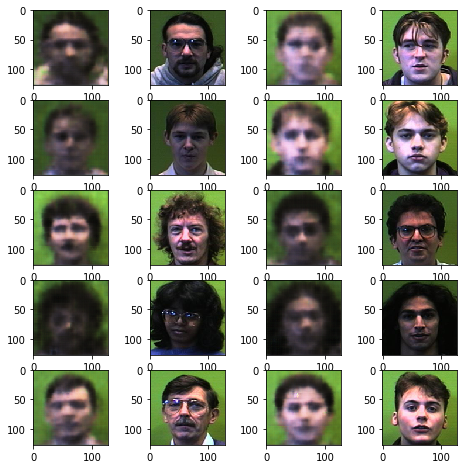

Epoch 30/100... Loss: 0.0165...
Epoch 30/100... Loss: 0.0158...
Epoch 30/100... Loss: 0.0164...
Epoch 30/100... Loss: 0.0190...
Epoch 31/100... Loss: 0.0161...
Epoch 31/100... Loss: 0.0170...
Epoch 31/100... Loss: 0.0157...
Epoch 31/100... Loss: 0.0155...
Epoch 32/100... Loss: 0.0159...
Epoch 32/100... Loss: 0.0157...


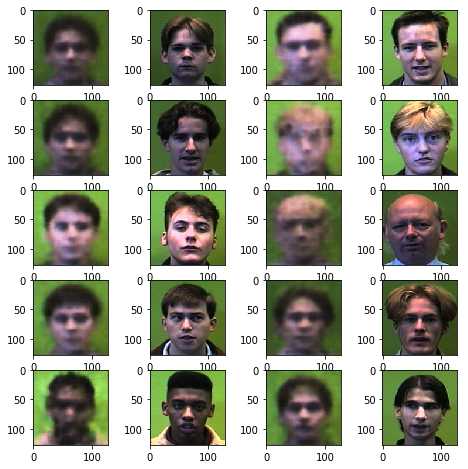

Epoch 32/100... Loss: 0.0161...
Epoch 32/100... Loss: 0.0170...
Epoch 32/100... Loss: 0.0156...
Epoch 33/100... Loss: 0.0162...
Epoch 33/100... Loss: 0.0165...
Epoch 33/100... Loss: 0.0152...
Epoch 33/100... Loss: 0.0165...
Epoch 33/100... Loss: 0.0164...
Epoch 34/100... Loss: 0.0159...
Epoch 34/100... Loss: 0.0159...


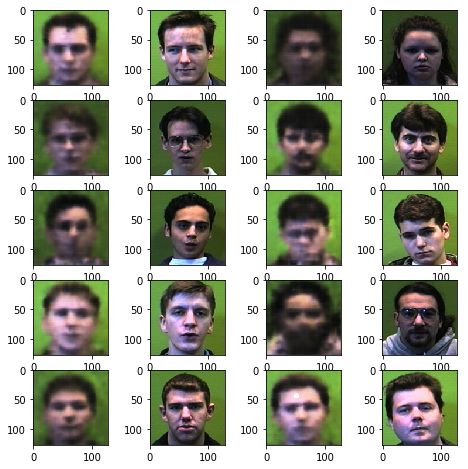

Epoch 34/100... Loss: 0.0166...
Epoch 34/100... Loss: 0.0162...
Epoch 34/100... Loss: 0.0158...
Epoch 35/100... Loss: 0.0155...
Epoch 35/100... Loss: 0.0162...
Epoch 35/100... Loss: 0.0156...
Epoch 35/100... Loss: 0.0166...
Epoch 35/100... Loss: 0.0171...
Epoch 36/100... Loss: 0.0164...
Epoch 36/100... Loss: 0.0151...


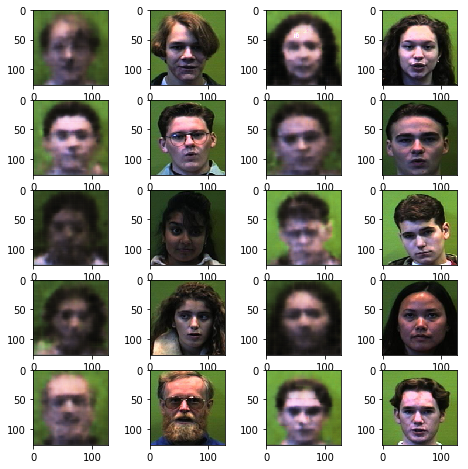

Epoch 36/100... Loss: 0.0150...
Epoch 36/100... Loss: 0.0173...
Epoch 37/100... Loss: 0.0155...
Epoch 37/100... Loss: 0.0168...
Epoch 37/100... Loss: 0.0158...
Epoch 37/100... Loss: 0.0155...
Epoch 37/100... Loss: 0.0155...
Epoch 38/100... Loss: 0.0161...
Epoch 38/100... Loss: 0.0153...
Epoch 38/100... Loss: 0.0177...


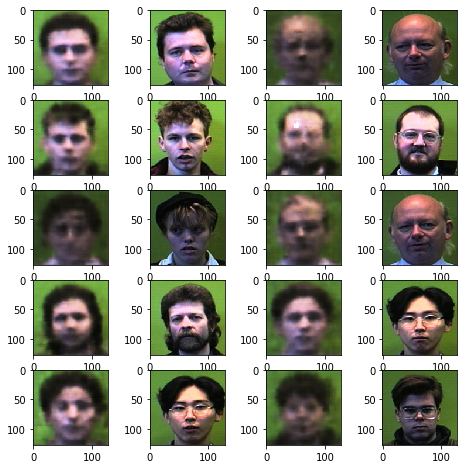

Epoch 38/100... Loss: 0.0155...
Epoch 38/100... Loss: 0.0158...
Epoch 39/100... Loss: 0.0161...
Epoch 39/100... Loss: 0.0160...
Epoch 39/100... Loss: 0.0175...
Epoch 39/100... Loss: 0.0158...
Epoch 39/100... Loss: 0.0150...
Epoch 40/100... Loss: 0.0154...
Epoch 40/100... Loss: 0.0162...
Epoch 40/100... Loss: 0.0179...


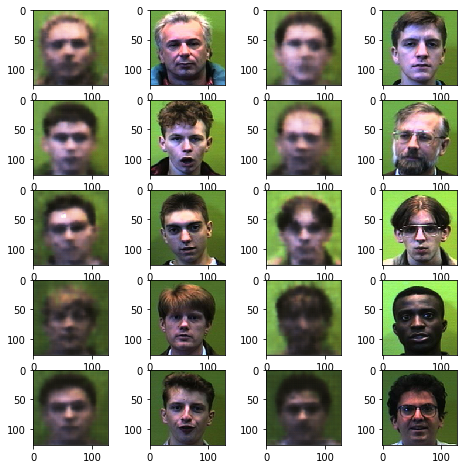

Epoch 40/100... Loss: 0.0162...
Epoch 40/100... Loss: 0.0166...
Epoch 41/100... Loss: 0.0161...
Epoch 41/100... Loss: 0.0158...
Epoch 41/100... Loss: 0.0159...
Epoch 41/100... Loss: 0.0171...
Epoch 42/100... Loss: 0.0162...
Epoch 42/100... Loss: 0.0156...
Epoch 42/100... Loss: 0.0156...
Epoch 42/100... Loss: 0.0150...


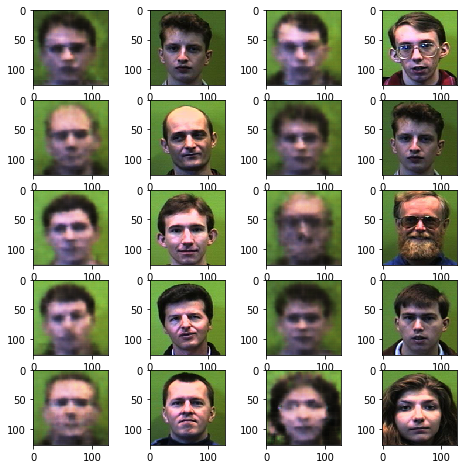

Epoch 42/100... Loss: 0.0151...
Epoch 43/100... Loss: 0.0151...
Epoch 43/100... Loss: 0.0165...
Epoch 43/100... Loss: 0.0147...
Epoch 43/100... Loss: 0.0173...
Epoch 43/100... Loss: 0.0155...
Epoch 44/100... Loss: 0.0147...
Epoch 44/100... Loss: 0.0164...
Epoch 44/100... Loss: 0.0152...
Epoch 44/100... Loss: 0.0155...


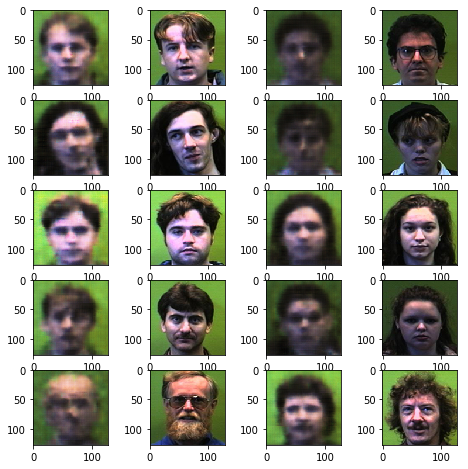

Epoch 44/100... Loss: 0.0157...
Epoch 45/100... Loss: 0.0168...
Epoch 45/100... Loss: 0.0157...
Epoch 45/100... Loss: 0.0163...
Epoch 45/100... Loss: 0.0154...
Epoch 45/100... Loss: 0.0161...
Epoch 46/100... Loss: 0.0158...
Epoch 46/100... Loss: 0.0157...
Epoch 46/100... Loss: 0.0149...
Epoch 46/100... Loss: 0.0148...


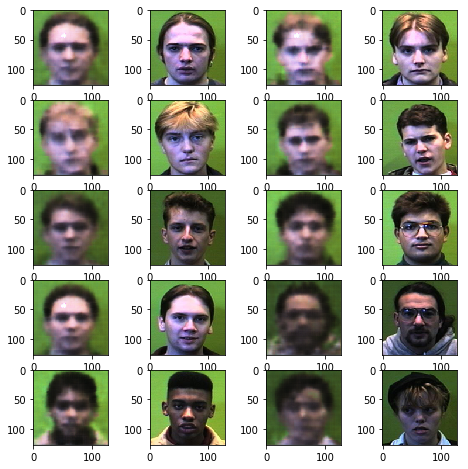

Epoch 47/100... Loss: 0.0167...
Epoch 47/100... Loss: 0.0157...
Epoch 47/100... Loss: 0.0165...
Epoch 47/100... Loss: 0.0154...
Epoch 47/100... Loss: 0.0151...
Epoch 48/100... Loss: 0.0157...
Epoch 48/100... Loss: 0.0156...
Epoch 48/100... Loss: 0.0156...
Epoch 48/100... Loss: 0.0152...
Epoch 48/100... Loss: 0.0144...


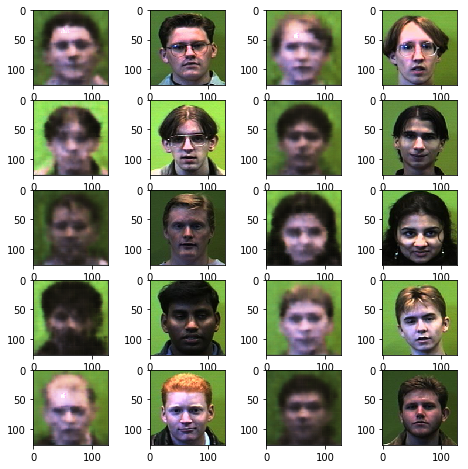

Epoch 49/100... Loss: 0.0152...
Epoch 49/100... Loss: 0.0162...
Epoch 49/100... Loss: 0.0155...
Epoch 49/100... Loss: 0.0155...
Epoch 49/100... Loss: 0.0151...
Epoch 50/100... Loss: 0.0149...
Epoch 50/100... Loss: 0.0165...
Epoch 50/100... Loss: 0.0155...
Epoch 50/100... Loss: 0.0153...
Epoch 50/100... Loss: 0.0145...


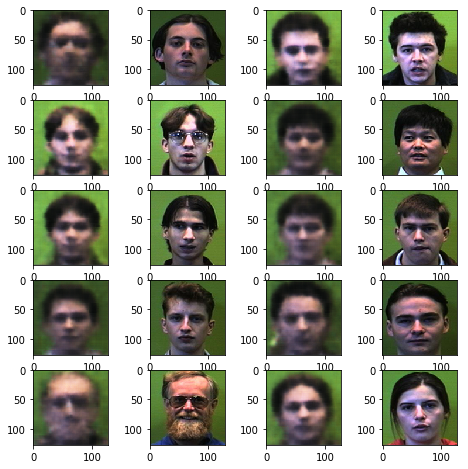

Epoch 51/100... Loss: 0.0153...
Epoch 51/100... Loss: 0.0163...
Epoch 51/100... Loss: 0.0151...
Epoch 51/100... Loss: 0.0154...
Epoch 52/100... Loss: 0.0164...
Epoch 52/100... Loss: 0.0154...
Epoch 52/100... Loss: 0.0155...
Epoch 52/100... Loss: 0.0158...
Epoch 52/100... Loss: 0.0153...
Epoch 53/100... Loss: 0.0147...


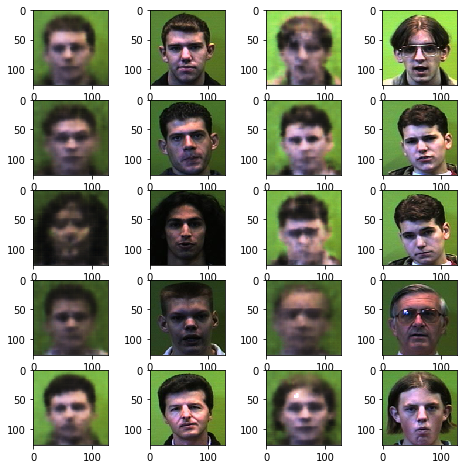

Epoch 53/100... Loss: 0.0164...
Epoch 53/100... Loss: 0.0154...
Epoch 53/100... Loss: 0.0157...
Epoch 53/100... Loss: 0.0157...
Epoch 54/100... Loss: 0.0151...
Epoch 54/100... Loss: 0.0164...
Epoch 54/100... Loss: 0.0159...
Epoch 54/100... Loss: 0.0152...
Epoch 54/100... Loss: 0.0155...
Epoch 55/100... Loss: 0.0169...


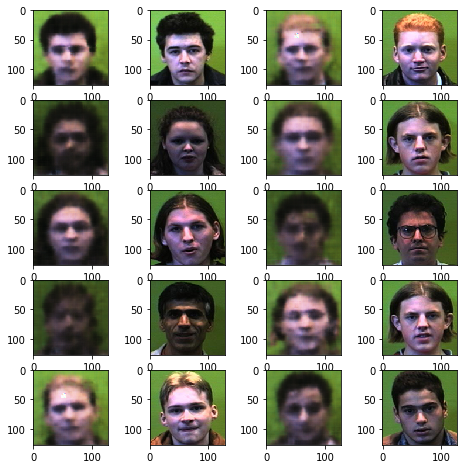

Epoch 55/100... Loss: 0.0155...
Epoch 55/100... Loss: 0.0161...
Epoch 55/100... Loss: 0.0148...
Epoch 55/100... Loss: 0.0154...
Epoch 56/100... Loss: 0.0152...
Epoch 56/100... Loss: 0.0151...
Epoch 56/100... Loss: 0.0151...
Epoch 56/100... Loss: 0.0149...
Epoch 57/100... Loss: 0.0156...
Epoch 57/100... Loss: 0.0149...


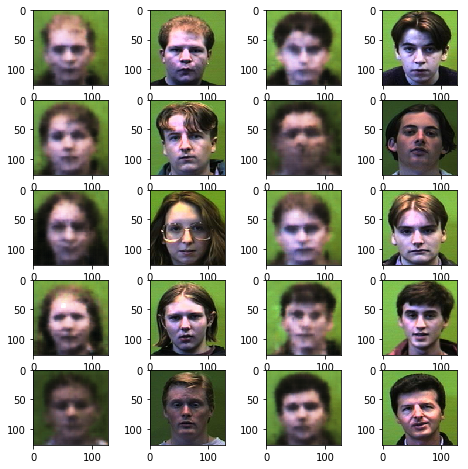

Epoch 57/100... Loss: 0.0161...
Epoch 57/100... Loss: 0.0158...
Epoch 57/100... Loss: 0.0156...
Epoch 58/100... Loss: 0.0162...
Epoch 58/100... Loss: 0.0160...
Epoch 58/100... Loss: 0.0159...
Epoch 58/100... Loss: 0.0154...
Epoch 58/100... Loss: 0.0162...
Epoch 59/100... Loss: 0.0148...
Epoch 59/100... Loss: 0.0163...


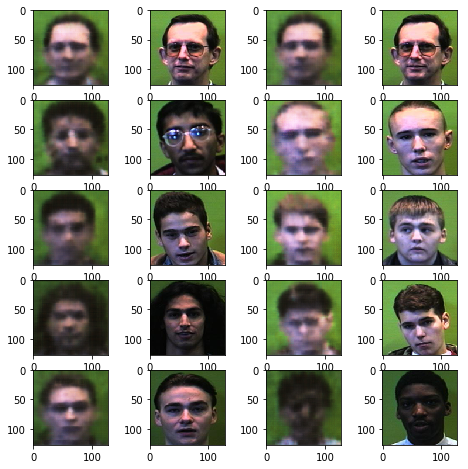

Epoch 59/100... Loss: 0.0160...
Epoch 59/100... Loss: 0.0144...
Epoch 59/100... Loss: 0.0174...
Epoch 60/100... Loss: 0.0153...
Epoch 60/100... Loss: 0.0156...
Epoch 60/100... Loss: 0.0148...
Epoch 60/100... Loss: 0.0162...
Epoch 60/100... Loss: 0.0164...
Epoch 61/100... Loss: 0.0154...
Epoch 61/100... Loss: 0.0151...


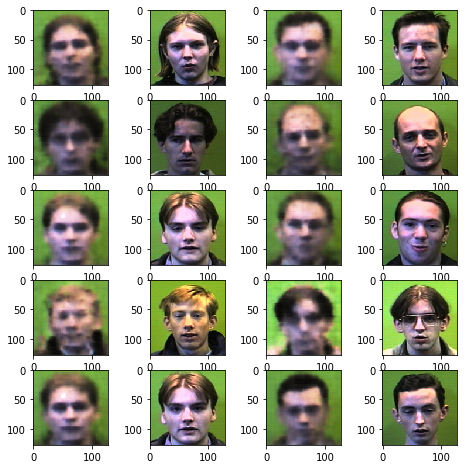

Epoch 61/100... Loss: 0.0149...
Epoch 61/100... Loss: 0.0158...
Epoch 62/100... Loss: 0.0153...
Epoch 62/100... Loss: 0.0154...
Epoch 62/100... Loss: 0.0146...
Epoch 62/100... Loss: 0.0151...
Epoch 62/100... Loss: 0.0162...
Epoch 63/100... Loss: 0.0157...
Epoch 63/100... Loss: 0.0146...
Epoch 63/100... Loss: 0.0149...


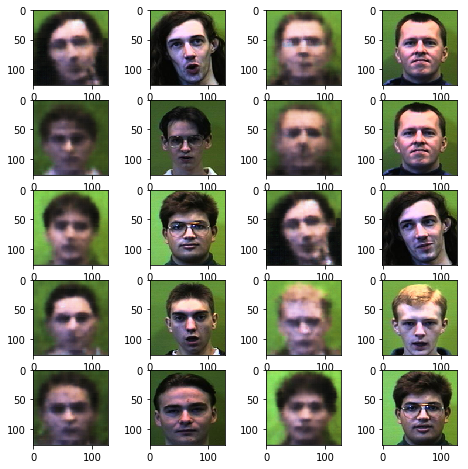

Epoch 63/100... Loss: 0.0162...
Epoch 63/100... Loss: 0.0147...
Epoch 64/100... Loss: 0.0163...
Epoch 64/100... Loss: 0.0163...
Epoch 64/100... Loss: 0.0151...
Epoch 64/100... Loss: 0.0147...
Epoch 64/100... Loss: 0.0144...
Epoch 65/100... Loss: 0.0158...
Epoch 65/100... Loss: 0.0153...
Epoch 65/100... Loss: 0.0147...


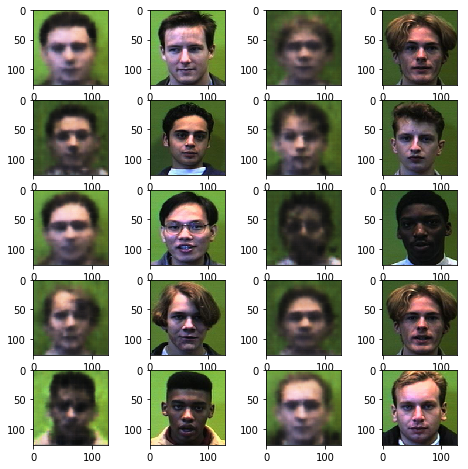

Epoch 65/100... Loss: 0.0153...
Epoch 65/100... Loss: 0.0151...
Epoch 66/100... Loss: 0.0147...
Epoch 66/100... Loss: 0.0153...
Epoch 66/100... Loss: 0.0150...
Epoch 66/100... Loss: 0.0153...
Epoch 67/100... Loss: 0.0150...
Epoch 67/100... Loss: 0.0167...
Epoch 67/100... Loss: 0.0165...
Epoch 67/100... Loss: 0.0152...


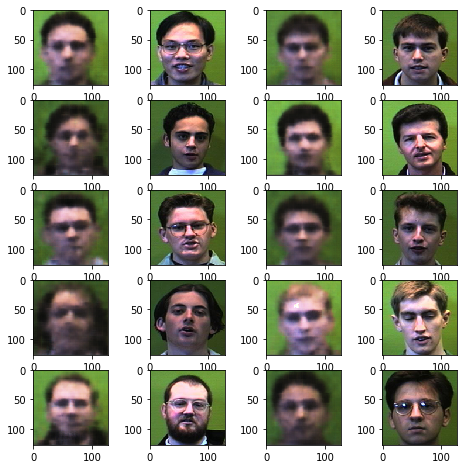

Epoch 67/100... Loss: 0.0147...
Epoch 68/100... Loss: 0.0153...
Epoch 68/100... Loss: 0.0157...
Epoch 68/100... Loss: 0.0159...
Epoch 68/100... Loss: 0.0145...
Epoch 68/100... Loss: 0.0158...
Epoch 69/100... Loss: 0.0157...
Epoch 69/100... Loss: 0.0154...
Epoch 69/100... Loss: 0.0163...
Epoch 69/100... Loss: 0.0162...


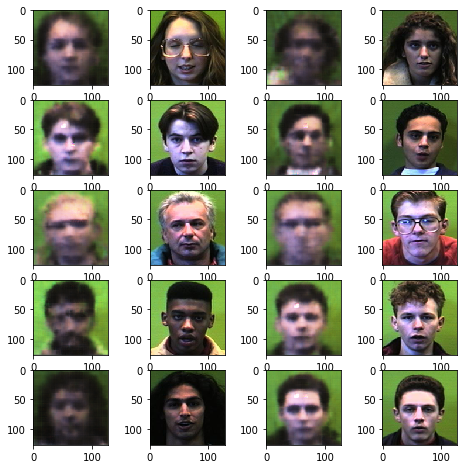

Epoch 69/100... Loss: 0.0160...
Epoch 70/100... Loss: 0.0154...
Epoch 70/100... Loss: 0.0153...
Epoch 70/100... Loss: 0.0147...
Epoch 70/100... Loss: 0.0158...
Epoch 70/100... Loss: 0.0139...
Epoch 71/100... Loss: 0.0149...
Epoch 71/100... Loss: 0.0145...
Epoch 71/100... Loss: 0.0155...
Epoch 71/100... Loss: 0.0148...


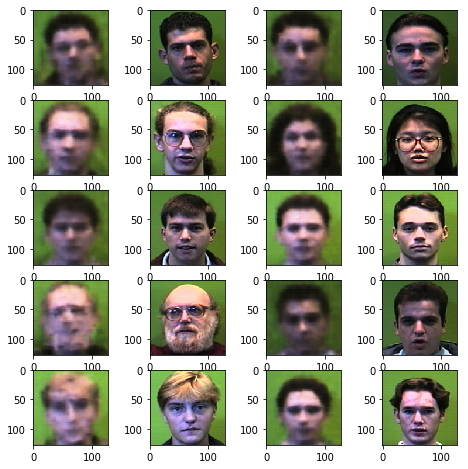

Epoch 72/100... Loss: 0.0150...
Epoch 72/100... Loss: 0.0155...
Epoch 72/100... Loss: 0.0147...
Epoch 72/100... Loss: 0.0156...
Epoch 72/100... Loss: 0.0159...
Epoch 73/100... Loss: 0.0146...
Epoch 73/100... Loss: 0.0147...
Epoch 73/100... Loss: 0.0171...
Epoch 73/100... Loss: 0.0151...
Epoch 73/100... Loss: 0.0160...


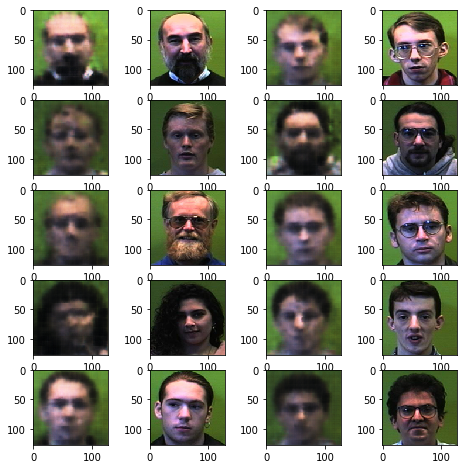

Epoch 74/100... Loss: 0.0155...
Epoch 74/100... Loss: 0.0150...
Epoch 74/100... Loss: 0.0158...
Epoch 74/100... Loss: 0.0153...
Epoch 74/100... Loss: 0.0155...
Epoch 75/100... Loss: 0.0156...
Epoch 75/100... Loss: 0.0166...
Epoch 75/100... Loss: 0.0159...
Epoch 75/100... Loss: 0.0164...
Epoch 75/100... Loss: 0.0150...


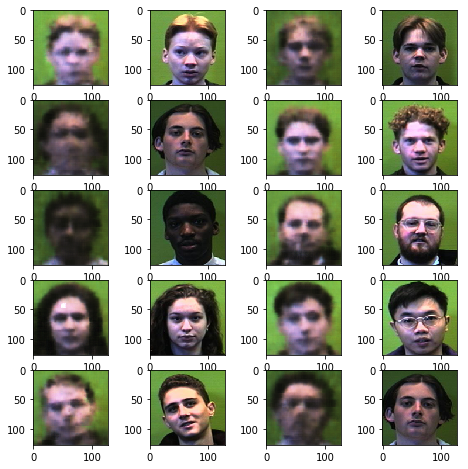

Epoch 76/100... Loss: 0.0148...
Epoch 76/100... Loss: 0.0144...
Epoch 76/100... Loss: 0.0162...
Epoch 76/100... Loss: 0.0164...
Epoch 77/100... Loss: 0.0152...
Epoch 77/100... Loss: 0.0150...
Epoch 77/100... Loss: 0.0150...
Epoch 77/100... Loss: 0.0159...
Epoch 77/100... Loss: 0.0155...
Epoch 78/100... Loss: 0.0151...


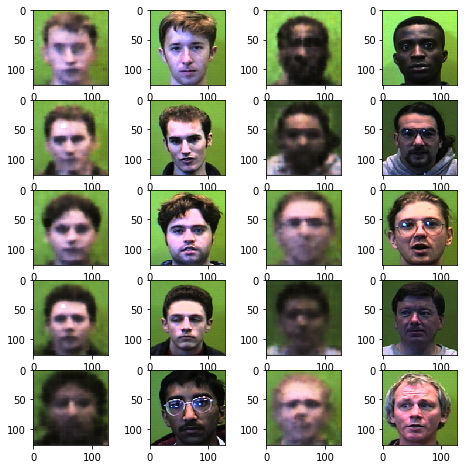

Epoch 78/100... Loss: 0.0154...
Epoch 78/100... Loss: 0.0161...
Epoch 78/100... Loss: 0.0153...
Epoch 78/100... Loss: 0.0150...
Epoch 79/100... Loss: 0.0143...
Epoch 79/100... Loss: 0.0146...
Epoch 79/100... Loss: 0.0151...
Epoch 79/100... Loss: 0.0147...
Epoch 79/100... Loss: 0.0161...
Epoch 80/100... Loss: 0.0161...


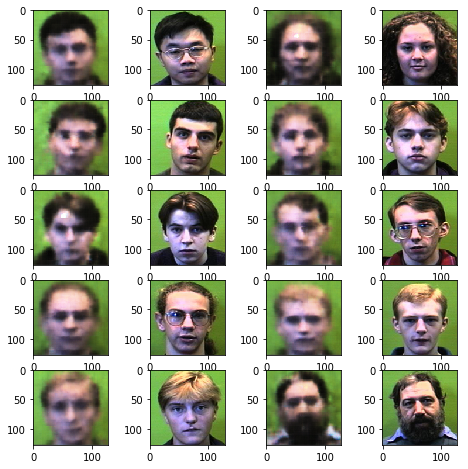

Epoch 80/100... Loss: 0.0147...
Epoch 80/100... Loss: 0.0148...
Epoch 80/100... Loss: 0.0153...
Epoch 80/100... Loss: 0.0155...
Epoch 81/100... Loss: 0.0155...
Epoch 81/100... Loss: 0.0147...
Epoch 81/100... Loss: 0.0152...
Epoch 81/100... Loss: 0.0152...
Epoch 82/100... Loss: 0.0151...
Epoch 82/100... Loss: 0.0145...


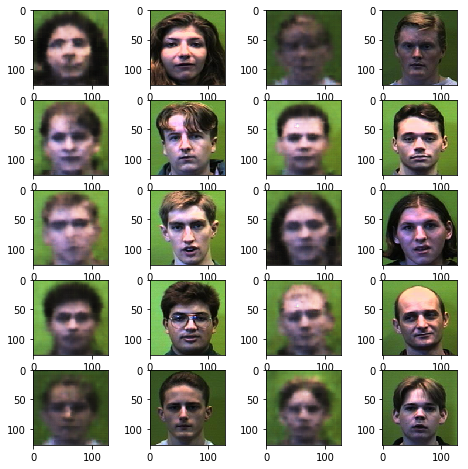

Epoch 82/100... Loss: 0.0169...
Epoch 82/100... Loss: 0.0157...
Epoch 82/100... Loss: 0.0150...
Epoch 83/100... Loss: 0.0148...
Epoch 83/100... Loss: 0.0150...
Epoch 83/100... Loss: 0.0148...
Epoch 83/100... Loss: 0.0149...
Epoch 83/100... Loss: 0.0155...
Epoch 84/100... Loss: 0.0149...
Epoch 84/100... Loss: 0.0147...


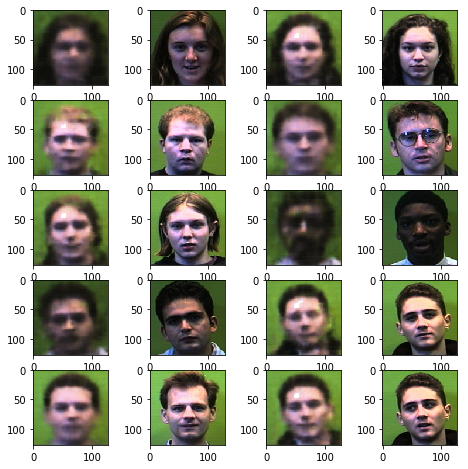

Epoch 84/100... Loss: 0.0149...
Epoch 84/100... Loss: 0.0154...
Epoch 84/100... Loss: 0.0146...
Epoch 85/100... Loss: 0.0152...
Epoch 85/100... Loss: 0.0148...
Epoch 85/100... Loss: 0.0148...
Epoch 85/100... Loss: 0.0155...
Epoch 85/100... Loss: 0.0152...
Epoch 86/100... Loss: 0.0148...
Epoch 86/100... Loss: 0.0150...


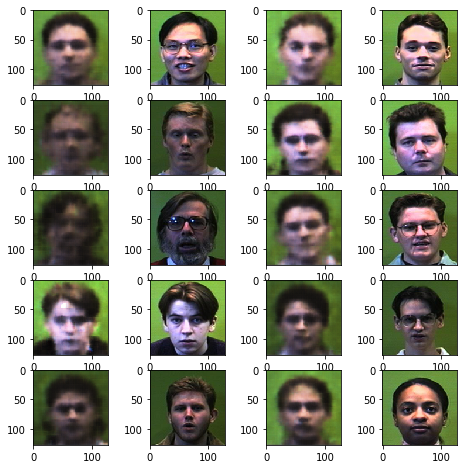

Epoch 86/100... Loss: 0.0151...
Epoch 86/100... Loss: 0.0157...
Epoch 87/100... Loss: 0.0163...
Epoch 87/100... Loss: 0.0148...
Epoch 87/100... Loss: 0.0153...
Epoch 87/100... Loss: 0.0152...
Epoch 87/100... Loss: 0.0150...
Epoch 88/100... Loss: 0.0156...
Epoch 88/100... Loss: 0.0145...
Epoch 88/100... Loss: 0.0157...


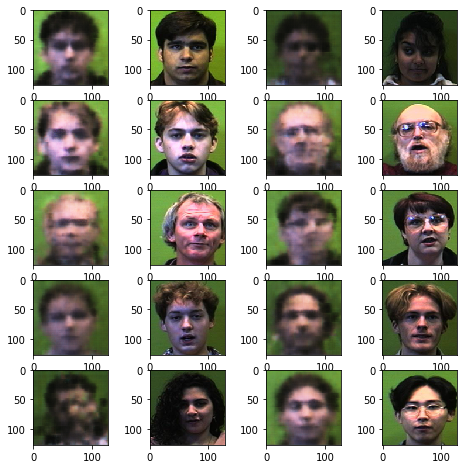

Epoch 88/100... Loss: 0.0144...
Epoch 88/100... Loss: 0.0164...
Epoch 89/100... Loss: 0.0150...
Epoch 89/100... Loss: 0.0145...
Epoch 89/100... Loss: 0.0161...
Epoch 89/100... Loss: 0.0155...
Epoch 89/100... Loss: 0.0159...
Epoch 90/100... Loss: 0.0147...
Epoch 90/100... Loss: 0.0157...
Epoch 90/100... Loss: 0.0147...


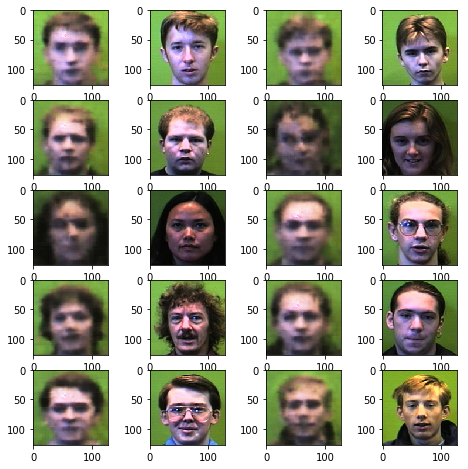

Epoch 90/100... Loss: 0.0163...
Epoch 90/100... Loss: 0.0153...
Epoch 91/100... Loss: 0.0144...
Epoch 91/100... Loss: 0.0150...
Epoch 91/100... Loss: 0.0147...
Epoch 91/100... Loss: 0.0158...
Epoch 92/100... Loss: 0.0152...
Epoch 92/100... Loss: 0.0156...
Epoch 92/100... Loss: 0.0159...
Epoch 92/100... Loss: 0.0150...


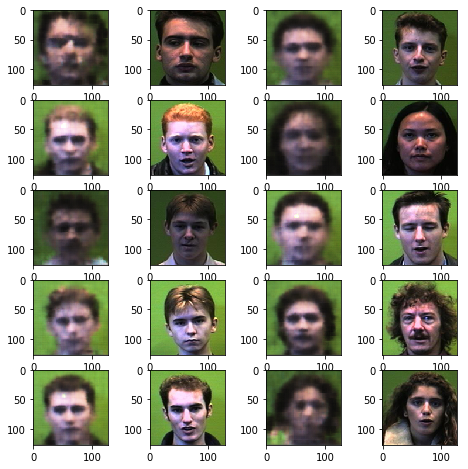

Epoch 92/100... Loss: 0.0167...
Epoch 93/100... Loss: 0.0153...
Epoch 93/100... Loss: 0.0143...
Epoch 93/100... Loss: 0.0159...
Epoch 93/100... Loss: 0.0151...
Epoch 93/100... Loss: 0.0153...
Epoch 94/100... Loss: 0.0149...
Epoch 94/100... Loss: 0.0151...
Epoch 94/100... Loss: 0.0148...
Epoch 94/100... Loss: 0.0147...


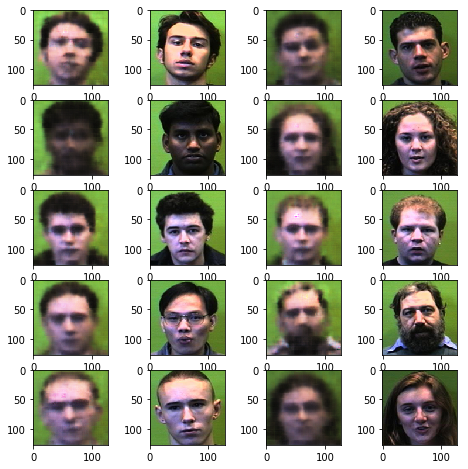

Epoch 94/100... Loss: 0.0143...
Epoch 95/100... Loss: 0.0137...
Epoch 95/100... Loss: 0.0155...
Epoch 95/100... Loss: 0.0154...
Epoch 95/100... Loss: 0.0161...
Epoch 95/100... Loss: 0.0170...
Epoch 96/100... Loss: 0.0152...
Epoch 96/100... Loss: 0.0148...
Epoch 96/100... Loss: 0.0151...
Epoch 96/100... Loss: 0.0149...


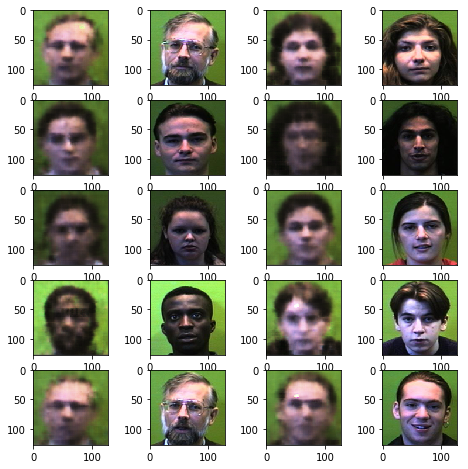

Epoch 97/100... Loss: 0.0150...
Epoch 97/100... Loss: 0.0147...
Epoch 97/100... Loss: 0.0156...
Epoch 97/100... Loss: 0.0147...
Epoch 97/100... Loss: 0.0143...
Epoch 98/100... Loss: 0.0155...
Epoch 98/100... Loss: 0.0153...
Epoch 98/100... Loss: 0.0141...
Epoch 98/100... Loss: 0.0151...
Epoch 98/100... Loss: 0.0142...


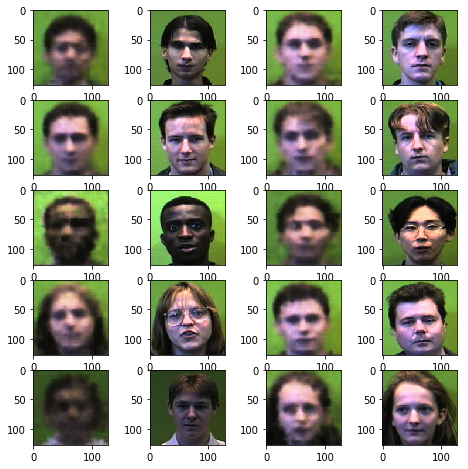

Epoch 99/100... Loss: 0.0146...
Epoch 99/100... Loss: 0.0149...
Epoch 99/100... Loss: 0.0147...
Epoch 99/100... Loss: 0.0144...
Epoch 99/100... Loss: 0.0155...
Epoch 100/100... Loss: 0.0154...
Epoch 100/100... Loss: 0.0155...
Epoch 100/100... Loss: 0.0159...
Epoch 100/100... Loss: 0.0146...
Epoch 100/100... Loss: 0.0162...


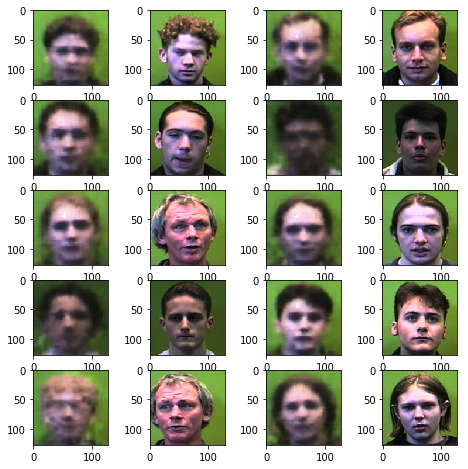

NameError: ignored

In [0]:
train(net,scaled_images,100,64)